<a href="https://colab.research.google.com/github/AceRb6/Analitica-y-visualizacion-avanzada-de-datos/blob/main/Proyecto_Final_AVDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ***Proyecto - Analitica y Visualizacion de Datos Avanzados***
***Alumnos:***

- *Cano Portugal Israel Daniel Arturo*

- *González Sosa Kevin Jesús*

- *Mondragón Aguilar Victor Hugo*

***Grupo: 6AV1***

**Objetivo del proyecto:**

El objetivo del proyecto es predecir los precios medios de las viviendas en California basándose en características como ubicación, número de habitaciones, ingresos medios de los residentes, etc. Este análisis puede ser útil para agentes inmobiliarios, urbanistas o inversores.

**Descripción del conjunto de datos:**

El conjunto de datos se obtuvo de Kaggle, sin embargo, el autor de dicha publicación indico que el origen del conjunto de datos se encuentra en el segundo capítulo del libro de Aurélien Géron "Hands-On Machine learning with Scikit-Learn and TensorFlow".

Link del conjunto de datos en Kaggle:
- https://www.kaggle.com/datasets/camnugent/california-housing-prices

El conjunto de datos contiene información de 1990 de un censo en California acerca de los precios de vivienda.

Se hace la aclaración en Kaggle que los datos no están limpios, por lo que se necesita realizar un preprocesamiento para su posterior utilización.


## **Librerías utilizadas.**


In [ ]:
!pip install -U xgboost

In [ ]:
!pip install -q skorch

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 228.9/228.9 kB 12.3 MB/s eta 0:00:00


In [ ]:
!pip install optuna

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from pandas import read_csv
import pandas as pd
import folium
from folium.plugins import MarkerCluster
import numpy as np

from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LassoCV, RidgeCV, lars_path, Ridge
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, PolynomialFeatures, SplineTransformer
from sklearn.model_selection import GridSearchCV, train_test_split, cross_val_score, KFold
from sklearn.pipeline import FeatureUnion, make_pipeline, Pipeline
from sklearn.cross_decomposition import PLSRegression
from sklearn.inspection import partial_dependence
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import cross_val_predict
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.cluster import KMeans, DBSCAN

from sklearn.neural_network import MLPRegressor
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, TensorDataset
from sklearn.metrics import mean_absolute_error, r2_score, silhouette_score, mean_squared_error
from sklearn.model_selection import KFold, cross_val_score

import statsmodels.formula.api as smf
import statsmodels.api as sm
from statsmodels.graphics.gofplots import qqplot
from statsmodels.stats.outliers_influence import OLSInfluence
from statsmodels.graphics.regressionplots import plot_leverage_resid2

from xgboost import XGBRegressor
from xgboost.callback import EarlyStopping

from IPython.display import Math

import optuna
from functools import partial

from IPython.display import display, Math, Latex

##**Identificación y selección de datos relevantes.**

In [ ]:
!wget --no-check-certificate 'https://drive.google.com/uc?export=download&id=1waXQXnghidEOZVGU0-NnXv0OmePsJail' -O data.csv

data = read_csv('data.csv')

display(data.head())

--2025-06-24 04:56:57--  https://drive.google.com/uc?export=download&id=1waXQXnghidEOZVGU0-NnXv0OmePsJail
Resolving drive.google.com (drive.google.com)... 172.253.122.138, 172.253.122.113, 172.253.122.102, ...
Connecting to drive.google.com (drive.google.com)|172.253.122.138|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://drive.usercontent.google.com/download?id=1waXQXnghidEOZVGU0-NnXv0OmePsJail&export=download [following]
--2025-06-24 04:56:57--  https://drive.usercontent.google.com/download?id=1waXQXnghidEOZVGU0-NnXv0OmePsJail&export=download
Resolving drive.usercontent.google.com (drive.usercontent.google.com)... 64.233.180.132, 2607:f8b0:4004:c21::84
Connecting to drive.usercontent.google.com (drive.usercontent.google.com)|64.233.180.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1423529 (1.4M) [application/octet-stream]
Saving to: ‘data.csv’

data.csv            100%[===================>]   1.36M  --.-KB/s  

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


## **Calidad de los datos adquiridos.**
Se verifica en este paso la calidad de los datos en cuanto a completitud, consistencia y relevancia de datos.

Es importante este paso ya que nos permite ver si existen potenciales problemas a tratar con los datos y pensar en la forma correcta de limpiarlos o transformarlos para mejorar su calidad.



In [ ]:
display(data.describe())
display(data.info())

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20433.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909
std,2.003532,2.135952,12.585558,2181.615252,421.385070,1132.462122,382.329753,1.899822,115395.615874
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1447.750000,296.000000,787.000000,280.000000,2.563400,119600.000000
50%,-118.490000,34.260000,29.000000,2127.000000,435.000000,1166.000000,409.000000,3.534800,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1725.000000,605.000000,4.743250,264725.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


None

*Observaciones:*

Obtenemos las métricas de cada variable númerica para obtener un vistazo general. En este caso observamos que en las variables total_rooms, total_bedrooms, population, households y median_value_house tienen datos que se salen por mucho de su rango intercuartílico (en sus valores máximos) lo que nos indica que existen datos atípicos, aunque no nos dice realmente si son muchos o pocos, pero si es importante porque nos alerta de verificar esos datos.

Luego imprimimos la información de las variablles, donde encontramos que existen datos nulos en la variable total_bedrooms, por lo que tendrémos que tratar con estos datos. Aquí también obtenemos el tipo de dato de cada variable, siendo que ocean_proximity se observa como un object ya que es probablemente contiene texto de forma compleja, es decir, un texto que indica categorías con caracterés especiales probablemente. Se deberá tratar lo anterior de alguna forma. También es necesario aclarar que la variable longitude y latitude pertenecen a coordenadas geográficas.

El principal problema del conjunto de datos por ahora se muestra en que no tiene completitud, por lo que se realizo en un paso posterior una imputación de datos a los valores faltante, después se muestra la existencia de valores atípicos, se necesitará saber si son muchos o pocos y tratar con ellos. Por último se deberá códificar la columna de ocean_proximity.

## **Preprocesamiento y limpieza de los datos.**

Se realiza el preprocesamiento y limpieza de datos, enfocandonos en encontrar valores faltantes, la existencia de valores atípicos y haciendo transformación de variables, incluyendo de las variables cualitativas.

In [ ]:
print(data.isnull().sum())

longitude               0
latitude                0
housing_median_age      0
total_rooms             0
total_bedrooms        207
population              0
households              0
median_income           0
median_house_value      0
ocean_proximity         0
dtype: int64


Se imputaran los datos nulos con la media redondeada del total de recamaras, o sea con el valor de 538. Lo anterior lo pensamos conveniente de realizar con la media del total de recamaras (con un valor entero, por lo que se redondeo a 538) ya que estos datos nulos son apenas el 1% de los datos que si están completos, por lo que utilizar la media sería útil y no afectaría demasiado en gran medida al no tener un valor real.

In [ ]:
data["total_bedrooms"].fillna(538, inplace=True)

/tmp/ipython-input-70-702156088.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data["total_bedrooms"].fillna(538, inplace=True)


In [ ]:
print(data.isnull().sum())
display(data.head())

longitude             0
latitude              0
housing_median_age    0
total_rooms           0
total_bedrooms        0
population            0
households            0
median_income         0
median_house_value    0
ocean_proximity       0
dtype: int64


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


Aquí comprobamos que no existen estos datos nulos y que no hubo una modificación general en los datos y solo a los datos faltantes.

**Codificación de variables categóricas.**

Para poder utilizar en modelos posteriores la columna ocean_proximity se hará una codificación con variables dummies.

In [ ]:
# One-Hot Encoding
data = pd.get_dummies(data, columns=['ocean_proximity'], drop_first=True)
# Remplaza espacios de las etiquetas de las columnas con "_"
data.columns = [col.replace(' ', '_') for col in data.columns]

# Mostrar las nuevas columnas
display(data.head())

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity_INLAND,ocean_proximity_ISLAND,ocean_proximity_NEAR_BAY,ocean_proximity_NEAR_OCEAN
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,False,False,True,False
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,False,False,True,False
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,False,False,True,False
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,False,False,True,False
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,False,False,True,False


**copia de datos geograficos**

Esto es porque para graficar los cluster y no afectar en graficas geograficas pueda tener una copia posible de visualizar despues de estandarizar el escalado

In [ ]:
# Copia geografica
data_geo = data[['longitude', 'latitude','median_house_value']].copy()

**Escalado estandarizado**

In [ ]:
# Escalar variables numéricas
scaler = StandardScaler()
numeric_columns = ['longitude','latitude','housing_median_age', 'total_rooms',
                   'total_bedrooms', 'population', 'households', 'median_income']
data[numeric_columns] = scaler.fit_transform(data[numeric_columns])

# Mostrar el dataset escalado
display(data)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity_INLAND,ocean_proximity_ISLAND,ocean_proximity_NEAR_BAY,ocean_proximity_NEAR_OCEAN
0,-1.327835,1.052548,0.982143,-0.804819,-0.975231,-0.974429,-0.977033,2.344766,452600.0,False,False,True,False
1,-1.322844,1.043185,-0.607019,2.045890,1.355085,0.861439,1.669961,2.332238,358500.0,False,False,True,False
2,-1.332827,1.038503,1.856182,-0.535746,-0.829735,-0.820777,-0.843637,1.782699,352100.0,False,False,True,False
3,-1.337818,1.038503,1.856182,-0.624215,-0.722402,-0.766028,-0.733781,0.932968,341300.0,False,False,True,False
4,-1.337818,1.038503,1.856182,-0.462404,-0.615070,-0.759847,-0.629157,-0.012881,342200.0,False,False,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...
20635,-0.758826,1.801647,-0.289187,-0.444985,-0.390863,-0.512592,-0.443449,-1.216128,78100.0,True,False,False,False
20636,-0.818722,1.806329,-0.845393,-0.888704,-0.925142,-0.944405,-1.008420,-0.691593,77100.0,True,False,False,False
20637,-0.823713,1.778237,-0.924851,-0.174995,-0.126109,-0.369537,-0.174042,-1.142593,92300.0,True,False,False,False
20638,-0.873626,1.778237,-0.845393,-0.355600,-0.307382,-0.604429,-0.393753,-1.054583,84700.0,True,False,False,False


El tipo de escalado que se aplicó a los datos es la Estandarización. Este método transforma cada característica numérica restando su media y dividiendo por su desviación estándar, lo que resulta en un nuevo conjunto de datos donde cada columna tiene una media de 0 y una desviación estándar de 1.

El motivo fundamental para realizar este escalado es que los algoritmos de Machine Learning que son sensibles a la distancia o que utilizan optimización por gradiente pueden verse negativamente afectados por variables en escalas muy diferentes. Por ejemplo, la variable population tiene valores en los miles, mientras que median_income tiene valores de un solo dígito. Sin escalar, un algoritmo podría interpretar erróneamente que population es una característica mucho más importante que median_income simplemente por la magnitud de sus valores. El escalado asegura que todas las características contribuyan de manera equitativa al resultado del modelo, mejorando la convergencia y el rendimiento general.

La implementación de este paso ha sido muy acertada, ya que se seleccionaron cuidadosamente solo las columnas de características numéricas, excluyendo correctamente las coordenadas geográficas, las columnas binarias creadas por el One-Hot Encoding y, fundamentalmente, la variable objetivo (median_house_value), la cual nunca debe ser escalada junto con las características.

### **Análisis y exploración de los datos (EDA).**

**Visualización de distribuciones y gráficas de caja de bigote.**

Al observar las distribuciones podemos ver mejor la forma en que los datos se concentran o se dispersan de acuerdo a su frecuencia y valor en la variable. Esto junto con las gráficas de caja de bigotes nos será útil para identificar los valores atípicos que antes habíamos supuesto su existencia.

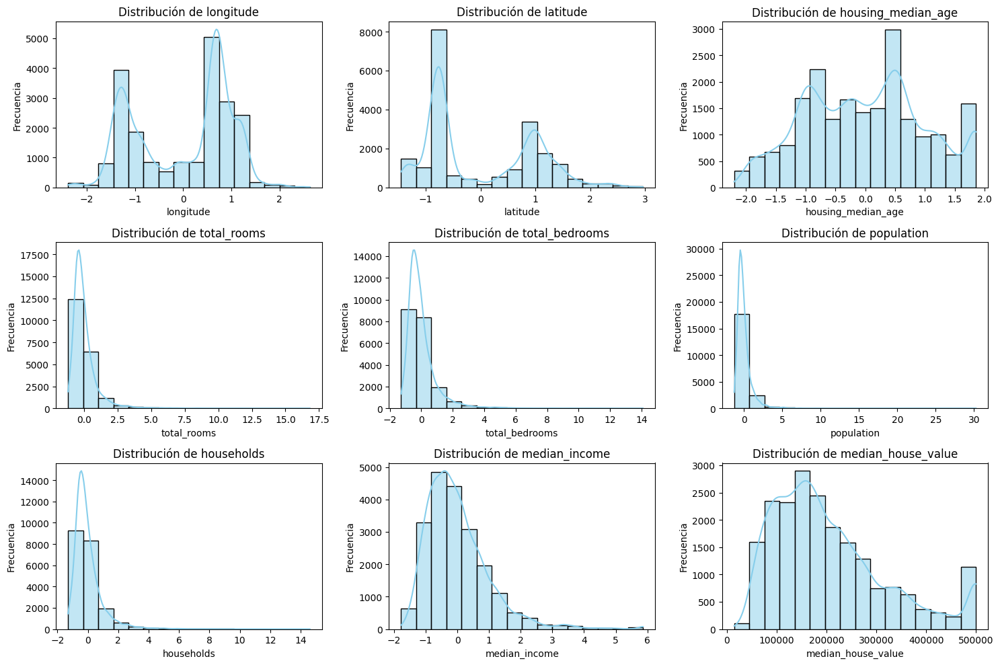

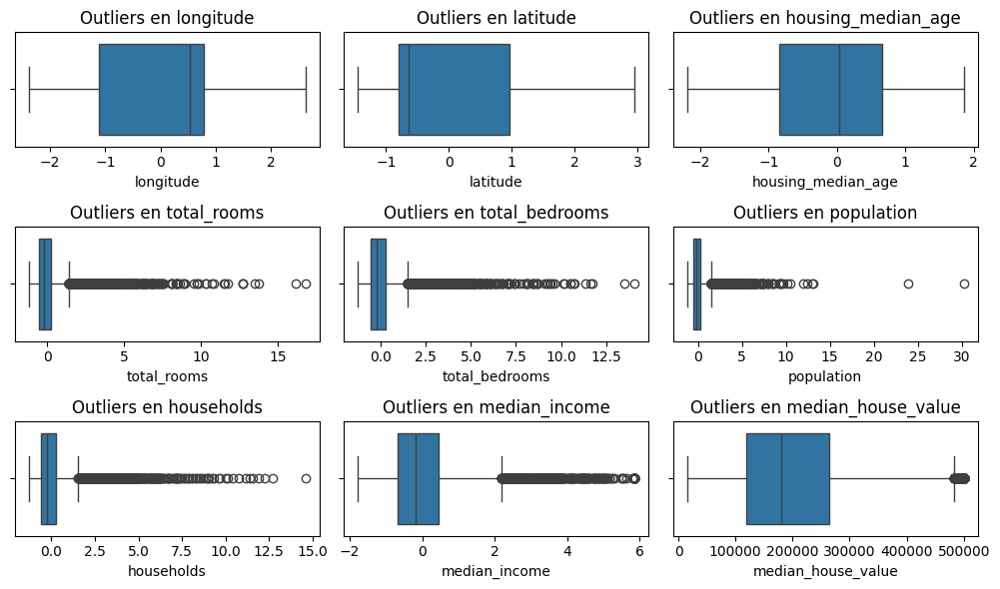

In [ ]:
# Lista de columnas a graficar
columns_to_plot = ['longitude', 'latitude', 'housing_median_age', 'total_rooms',
                   'total_bedrooms', 'population', 'households', 'median_income', 'median_house_value']
stur=int(1+3.322*np.log10(len(data)))+1

# Histogramas para cada columna
plt.figure(figsize=(15, 10))
for i, column in enumerate(columns_to_plot, 1):
    plt.subplot(3, 3, i)  # Organiza los gráficos en una cuadrícula de 3x3
    sns.histplot(data[column], kde=True, bins=stur, color='skyblue')
    plt.title(f'Distribución de {column}')
    plt.xlabel(column)
    plt.ylabel('Frecuencia')

plt.tight_layout()  # Ajusta el espacio entre los subgráficos
plt.show()

# Diagrama de caja para detectar outliers en 'median_house_value'
plt.figure(figsize=(10, 6))
for i, column in enumerate(columns_to_plot, 1):
    plt.subplot(3, 3, i)  # Organiza los gráficos en una cuadrícula de 3x3
    sns.boxplot(x=data[column])
    plt.title(f'Outliers en {column}')
    plt.xlabel(column)

plt.tight_layout()  # Ajusta el espacio entre los subgráficos
plt.show()


**Observaciones:**

Distribuciones:
1. La mayoría de las variables no siguen una distribución normal.
  - Variables como total_rooms, total_bedrooms, population y households tienen una distribución sesgada a la derecha (colas largas).
  - median_income tiene una forma más parecida a una distribución normal, pero aún está ligeramente sesgada.
2. Algunas variables parecen estar agrupadas en ciertos valores.
  - longitude y latitude muestran picos en ciertas regiones, lo que puede reflejar una concentración geográfica específica.
  - housing_median_age tiene varios picos, lo que sugiere que hay ciertos años predominantes en la construcción de viviendas.
3. Escalado aplicado correctamente.
  - Los valores están centrados alrededor de 0, lo que confirma la transformación con StandardScaler.


Caja de bigotes:
1. Las variables total_rooms, total_bedrooms, population y households tienen muchos atípicos.
  - Estos valores extremos pueden afectar modelos sensibles a valores atípicos, como regresión lineal.
  - Se podría considerar el uso de transformaciones (logarítmica, raíz cuadrada) o eliminación de atípicos basada en cuantiles.
2. Las variables longitude, latitude, y housing_median_age no presentan valores atípicos significativos.
  - Estas variables están dentro de rangos esperados, lo que sugiere que no hay errores evidentes en los datos geográficos o de antigüedad de viviendas.
3. median_income muestra algunos valores atípicos, pero en menor cantidad.
  - Dado que los ingresos no siguen una distribución normal perfecta, podría ser útil analizar su impacto en el modelo antes de decidir si tratarlos.


**Mapa de calor de correlación entre variables.**

Realizamos un gráfico de las correlaciones entre variables para entender como se comportan las variables con respecto a otras y saber si existen correlaciones fuertes o débiles, ya sean positivas o negativas.

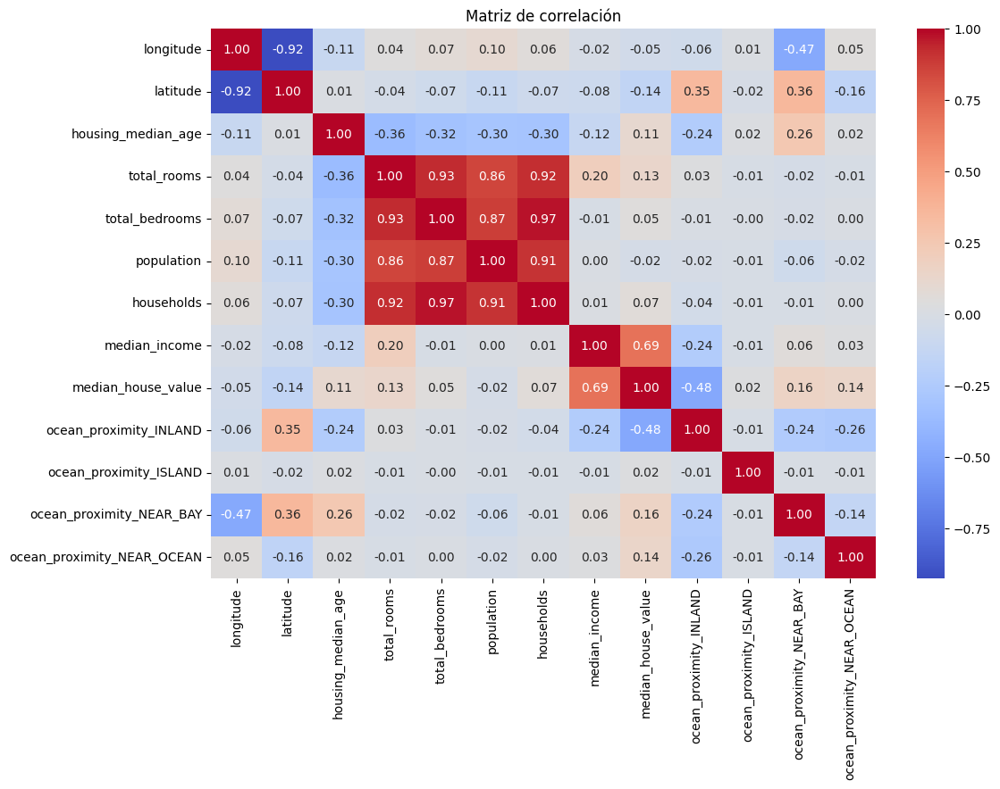

In [ ]:
# Matriz de correlación
correlation_matrix = data.corr()

# Mapa de calor
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Matriz de correlación')
plt.show()

**Explicando la correlacion de nuestro dataset:**


*   "median_income" y "median_house_value" son los que nos permitiran predecir los precios y al ver la relacion que tienen son factores importantes
*   total_rooms, total_bedrooms, population y households al tener alta correlacion entre ellas lo muestra una multicolinealidad
*   longitude y latitude tienen una fuerte correlación negativa (-0.92), reflejando la geografía alargada de California.
*   housing_median_age tiene una correlación negativa con varias métricas de tamaño (todas alrededor de -0.30), indicando que las construcciones más antiguas tienden a ser más pequeñas.
*   Incluso la relacion entre media de precio de la casa y la proximidad del oceano en "inland" muestra que si esta en esta caracteristica decrece su precio




**Gráfico bivariado entre median_income y median_house_value.**

Se hace una gráfica bivariada de nuestras principales variables de intéres para un modelo de regresión.

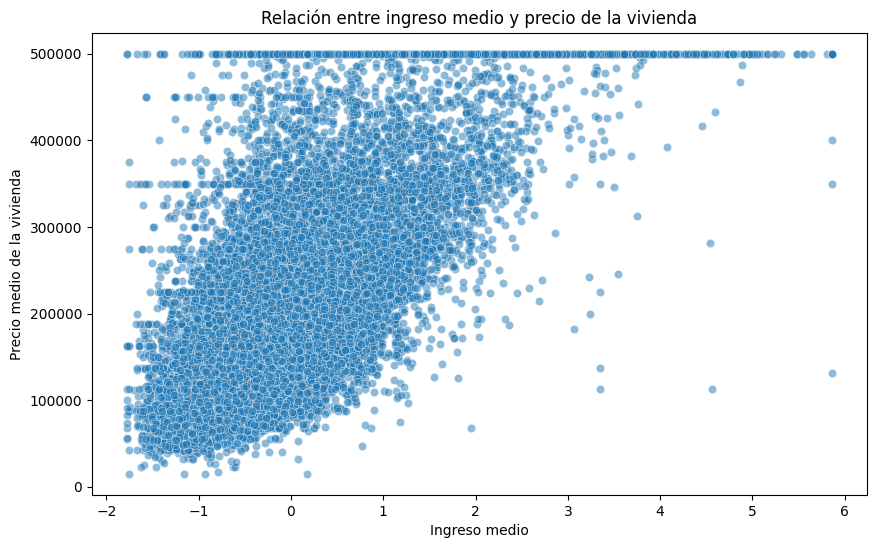

In [ ]:
# Gráfico de dispersión entre median_income y median_house_value
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data['median_income'], y=data['median_house_value'], alpha=0.5)
plt.title('Relación entre ingreso medio y precio de la vivienda')
plt.xlabel('Ingreso medio')
plt.ylabel('Precio medio de la vivienda')
plt.show()

### **Tratamiento de Outliers**

total_rooms, total_bedrooms, population y households presentan muchos outliers en el extremo superior.

Hay propiedades con números extremadamente altos de habitaciones, población o hogares, que probablemente representan áreas densamente pobladas o complejos múltiples.

Para el tratamiento de estos valores atípicos consideramos la opción de eliminarlos del conjunto de datos para tener datos más consistentes. Para eso primero codificamos la identificación de valores atípicos en las variables y entre intervalos de datos.

In [ ]:
# Rango de valores para contar
ranges = range(0, 550000, 25000)

# Iterar por los rangos y contar los registros]
for i in range(len(ranges) - 1):
  count = len(data[(data['median_house_value'] >= ranges[i]) & (data['median_house_value'] < ranges[i+1])])
  print(f"Registros entre {ranges[i]} y {ranges[i+1]}: {count}")

Registros entre 0 y 25000: 9
Registros entre 25000 y 50000: 190
Registros entre 50000 y 75000: 1450
Registros entre 75000 y 100000: 1947
Registros entre 100000 y 125000: 1927
Registros entre 125000 y 150000: 2033
Registros entre 150000 y 175000: 2371
Registros entre 175000 y 200000: 1958
Registros entre 200000 y 225000: 1471
Registros entre 225000 y 250000: 1455
Registros entre 250000 y 275000: 1123
Registros entre 275000 y 300000: 840
Registros entre 300000 y 325000: 583
Registros entre 325000 y 350000: 631
Registros entre 350000 y 375000: 547
Registros entre 375000 y 400000: 334
Registros entre 400000 y 425000: 267
Registros entre 425000 y 450000: 210
Registros entre 450000 y 475000: 187
Registros entre 475000 y 500000: 115
Registros entre 500000 y 525000: 992


In [ ]:
# Rango de valores para contar
ranges = range(0, 550000, 10000)

# Iterar por los rangos y contar los registros
for i in range(len(ranges) - 1):
  count = len(data[(data['median_house_value'] >= ranges[i]) & (data['median_house_value'] < ranges[i+1])])
  print(f"Registros entre {ranges[i]} y {ranges[i+1]}: {count}")

Registros entre 0 y 10000: 0
Registros entre 10000 y 20000: 5
Registros entre 20000 y 30000: 9
Registros entre 30000 y 40000: 26
Registros entre 40000 y 50000: 159
Registros entre 50000 y 60000: 482
Registros entre 60000 y 70000: 627
Registros entre 70000 y 80000: 600
Registros entre 80000 y 90000: 768
Registros entre 90000 y 100000: 920
Registros entre 100000 y 110000: 734
Registros entre 110000 y 120000: 847
Registros entre 120000 y 130000: 727
Registros entre 130000 y 140000: 850
Registros entre 140000 y 150000: 802
Registros entre 150000 y 160000: 970
Registros entre 160000 y 170000: 1005
Registros entre 170000 y 180000: 807
Registros entre 180000 y 190000: 853
Registros entre 190000 y 200000: 694
Registros entre 200000 y 210000: 537
Registros entre 210000 y 220000: 639
Registros entre 220000 y 230000: 679
Registros entre 230000 y 240000: 577
Registros entre 240000 y 250000: 494
Registros entre 250000 y 260000: 448
Registros entre 260000 y 270000: 461
Registros entre 270000 y 28000

Los outliers de median_house_value e median_income parecen ser valores reales y legitimos en base a su comportamiento, consideramos quitarlos pero vimos que sin ellos bajan a un aproximado de 16000 datos pero se pierde mucha informacion, podriamos tratar los datos con un valor logaritmico para no perder estos datos en el momento de hacer el modelo pero sera de ver como se adapta dicho modelo.

**Identificación de Outliers :**

In [ ]:
# Identificar outliers usando IQR
def detect_outliers_iqr(column):
    Q1 = column.quantile(0.25)
    Q3 = column.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return (column < lower_bound) | (column > upper_bound)

for col in ['total_rooms', 'total_bedrooms', 'population', 'households', 'median_income']:
    outliers = detect_outliers_iqr(data[col])
    print(f"Outliers en {col}: {outliers.sum()}")

Outliers en total_rooms: 1287
Outliers en total_bedrooms: 1306
Outliers en population: 1196
Outliers en households: 1220
Outliers en median_income: 681


In [ ]:
#eliminar outliers
data = data[~detect_outliers_iqr(data['total_rooms'])]
data = data[~detect_outliers_iqr(data['total_bedrooms'])]
data = data[~detect_outliers_iqr(data['population'])]
data = data[~detect_outliers_iqr(data['households'])]
data = data[~detect_outliers_iqr(data['median_income'])]

In [ ]:
# Get the index of the remaining data after removing outliers
remaining_indices = data.index

# Filter data_geo using the remaining indices
data_geo = data_geo.loc[remaining_indices]

Se quedan un total de 17532 datos que no cuentan con datos atípicos en las variables identificadas.

**Comprobación en gráficos de la consistencia actualizada de los datos.**

Volvimos a gráficar los datos de las variables para ver la diferencia entre nuestros primeros datos sin tratar y los que no contienen datos atípicos.

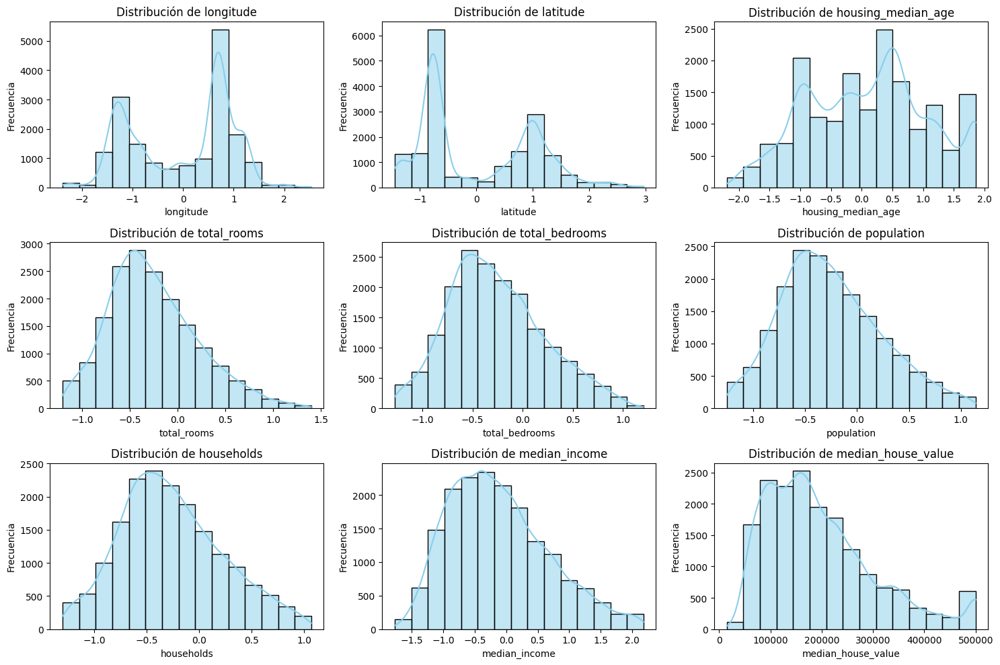

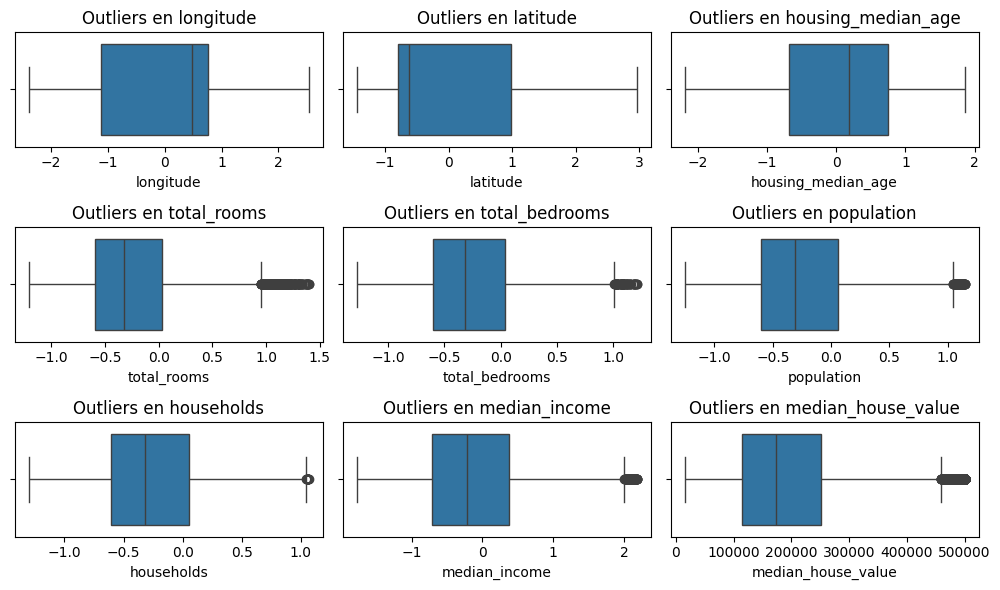

In [ ]:
# Lista de columnas a graficar
columns_to_plot = ['longitude', 'latitude', 'housing_median_age', 'total_rooms',
                   'total_bedrooms', 'population', 'households', 'median_income','median_house_value']
stur=int(1+3.322*np.log10(len(data)))

# Histogramas para cada columna
plt.figure(figsize=(15, 10))
for i, column in enumerate(columns_to_plot, 1):
    plt.subplot(3, 3, i)  # Organiza los gráficos en una cuadrícula de 3x3
    sns.histplot(data[column], kde=True, bins=stur, color='skyblue')
    plt.title(f'Distribución de {column}')
    plt.xlabel(column)
    plt.ylabel('Frecuencia')

plt.tight_layout()  # Ajusta el espacio entre los subgráficos
plt.show()

# Diagrama de caja para detectar outliers en 'median_house_value'
plt.figure(figsize=(10, 6))
for i, column in enumerate(columns_to_plot, 1):
    plt.subplot(3, 3, i)  # Organiza los gráficos en una cuadrícula de 3x3
    sns.boxplot(x=data[column])
    plt.title(f'Outliers en {column}')
    plt.xlabel(column)

plt.tight_layout()  # Ajusta el espacio entre los subgráficos
plt.show()


Se observa una disminución considerable en cuanto a valores atípicos y rangos de las variables en las gráficas. Quedan algunos datos fuera del rango intercuartil pero esto lo consideramos apropiado para considerar después las casas que tienen un valor muy alto y no son necesariamente errores del conjunto de datos.

Creemos que es importante aclarar que probablemente en un modelo posterior se pueda tomar la decisión de como tratamos estos datos, es decir, al analizar el conjunto de datos encontramos con valores, en este caso casas, con un valor elevado y esto en el contexto de viviendas es muy probable que sean datos reales y por lo tanto no es la mejor idea eliminarlos.

**Comprobación en mapa de calor.**

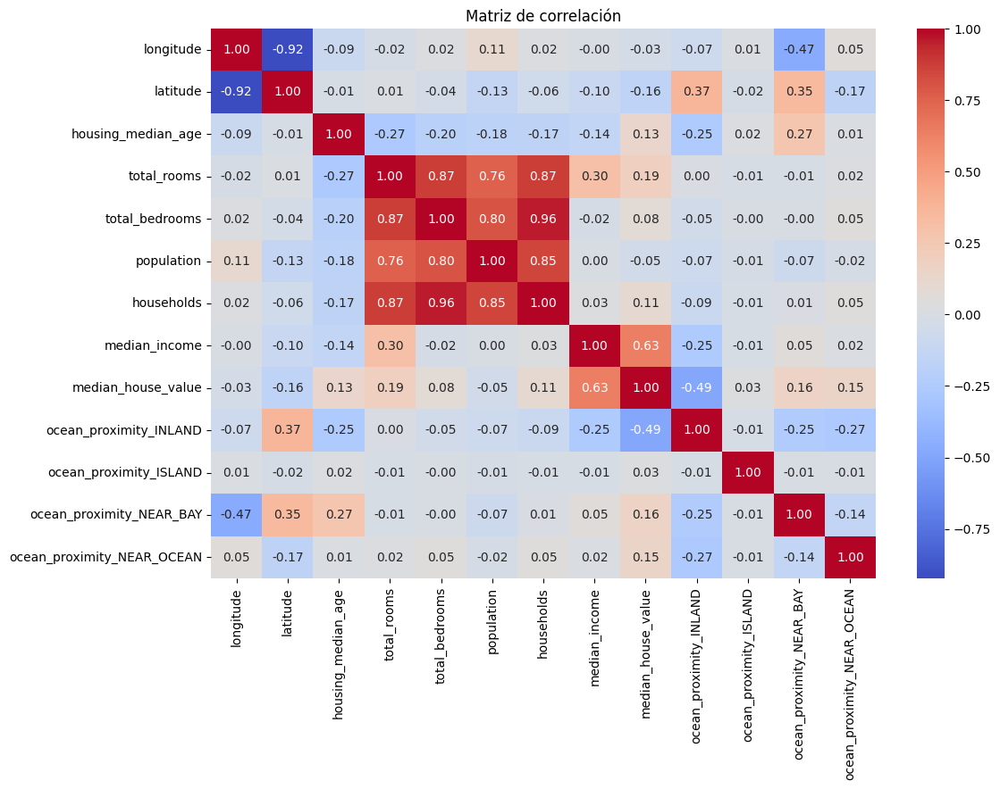

In [ ]:
# Matriz de correlación
correlation_matrix = data.corr()

# Mapa de calor
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Matriz de correlación')
plt.show()

Hay un cambio ligero en las correlaciones, en su mayoría se bajo el valor de correlación que tenian las variables.

**Nuevas métricas calculadas en el conjunto de datos.**

In [ ]:
display(data.describe())

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,17532.000000,17532.000000,17532.000000,17532.000000,17532.000000,17532.000000,17532.000000,17532.000000,17532.000000
mean,-0.022609,0.029282,0.101142,-0.254723,-0.261040,-0.251322,-0.260939,-0.118772,196574.940794
std,1.000569,1.013112,0.975438,0.470606,0.477369,0.483345,0.487546,0.787530,107345.354381
min,-2.385992,-1.447568,-2.196180,-1.207283,-1.278148,-1.256123,-1.301368,-1.774299,14999.000000
25%,-1.113209,-0.792107,-0.686477,-0.588002,-0.605529,-0.599131,-0.608232,-0.713622,113900.000000
50%,0.479018,-0.623560,0.187562,-0.318012,-0.316923,-0.308607,-0.315284,-0.217063,173800.000000
75%,0.763522,0.987002,0.743768,0.028185,0.038468,0.058744,0.053516,0.375112,251725.000000
max,2.535437,2.958068,1.856182,1.399106,1.207204,1.144016,1.068372,2.181904,500001.000000


Ahora se encuentran menos registros en el conjunto de datos y como se observo anteriormente se eliminaron muchos valores atípicos, aunque aún persisten valores muy altos, en el contexto del conjunto de datos puede deberse a zonas con un alto estatus socioeconómico y el valor alto de propiedades existentes para estas personas.

### **Análisis geográfico**


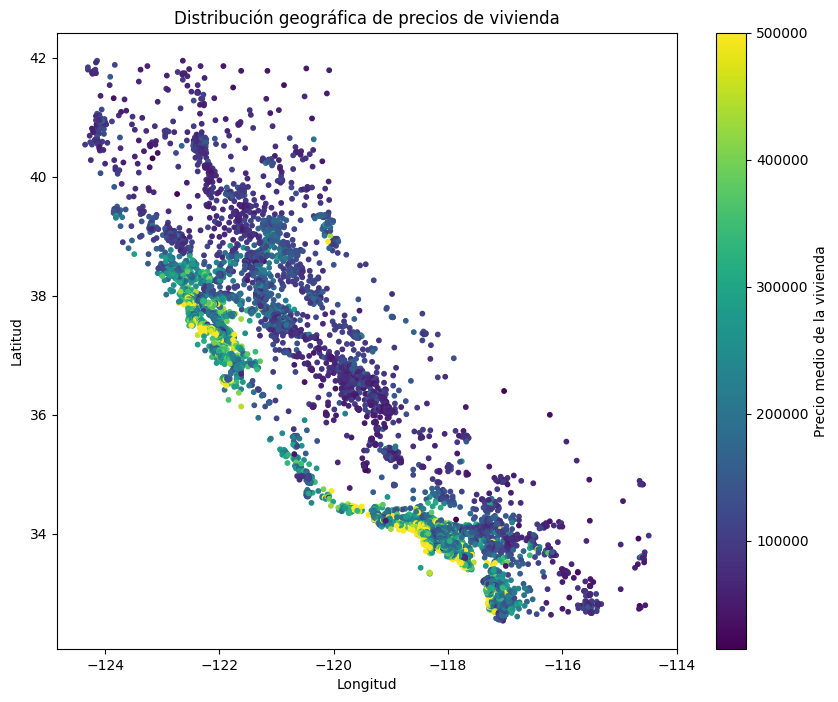

In [ ]:
# Gráfico de dispersión geográfica
plt.figure(figsize=(10, 8))
plt.scatter(data_geo['longitude'], data_geo['latitude'], c=data_geo['median_house_value'], cmap='viridis', s=10)
plt.colorbar(label='Precio medio de la vivienda')
plt.title('Distribución geográfica de precios de vivienda')
plt.xlabel('Longitud')
plt.ylabel('Latitud')
plt.show()

Se puede observar que entre más cerca este de una costa más aumenta su precio, probablemente se deba a su accesibilidad con el mar o las vistas que pueden tener estas viviendas, más a parte su valor turístico.

**Clustering geográfico :**

Se puede usar técnicas de clustering (como K-Means) para agrupar las propiedades en regiones geográficas similares. Esto puede capturar mejor la influencia de la ubicación en los precios.

In [ ]:
# Crear un mapa centrado en una ubicación específica
mapa = folium.Map(location=[data_geo['latitude'].mean(), data_geo['longitude'].mean()], zoom_start=6)

# Agregar puntos al mapa
marker_cluster = MarkerCluster().add_to(mapa)

for idx, row in data_geo.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=3,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6,
        popup=f"Precio: {row['median_house_value']}, Latitud:{row['latitude']}, Longitud:{row['longitude']}"
    ).add_to(marker_cluster)

# Mostrar el mapa
mapa

##**Selección de caracterísicas.**

### **Tratar la Multicolinealidad**
En este caso las variables con una correlación alta que son:
*   Total rooms
*   Total bedrooms
*   Population
*   Households

por ende usaremos PCA para nuestras variables más correlacionadas las cuales son son: total_rooms, total_bedrooms, population y households. Llegando la máxima correlación a 0.96, lo que nos sugiere que considerar estas variables de esta manera solo agregaran datos redundantes, por lo que una solución a esto es utilizar PCA (Análisis de Componentes Principales) para estas variables correlacionadas y así reducir estas cuatro variables a menos componentes sin perder por completo la interpretabilidad al realizar una transformación completa en los datos.


In [ ]:
# Variables para PCA (las que mostraron alta correlación)
pca_vars = ['total_rooms', 'total_bedrooms', 'population', 'households']

# Estandarización
scaler = StandardScaler()
scaled_data = scaler.fit_transform(data[pca_vars])

# Aplicación de PCA
pca = PCA(n_components=0.95)  # Conservar 95% de varianza
principal_components = pca.fit_transform(scaled_data)

# Resultados del PCA
print(f"Varianza explicada por cada componente: {pca.explained_variance_ratio_}")
print(f"Varianza total explicada: {sum(pca.explained_variance_ratio_):.2f}")

# Crear nuevas columnas
data['pca_comp_1'] = principal_components[:, 0]
if principal_components.shape[1] > 1:
    data['pca_comp_2'] = principal_components[:, 1]

# Podemos eliminar las variables originales si lo deseamos
data.drop(pca_vars, axis=1, inplace=True)

Varianza explicada por cada componente: [0.89083594 0.06453702]
Varianza total explicada: 0.96


PCA se aplica solo a las 4 variables correlacionadas para evitar redundancia. El primer componente captura el 89% de la varianza (suficiente para modelado) y con el segundo el 95% aproximadamente.

Decidimos quedarnos solo con los componentes estarías descartando conscientemente el 6% de la varianza que captura el segundo componente. Aunque parece poco, esa información no es "ruido" aleatorio; es el segundo patrón más importante en tus datos (lo que interpretamos como la "composición o densidad" del distrito). Podría ser un matiz que ayude al modelo a diferenciar entre distritos que son igualmente "grandes" pero estructuralmente diferentes.

El componente 1 de su variables todas miden el tamaño general, la escala o la magnitud de un distrito censal. Un distrito con mucha población también tendrá muchos hogares, que a su vez tendrán muchas habitaciones y dormitorios. Se puede interpretar como un "Índice de Magnitud del Distrito". Es una única y potente métrica que resume el "tamaño" general de la zona.

Mientras que el componente 2 considerando que el tamaño no importa, lo que importa es la relación o proporción entre las variables. Por ejemplo, la cantidad de personas por habitación, o el número de habitaciones por hogar. Se puede interpretar como un "Índice de Composición o Densidad Relativa". Mide la estructura interna del distrito, independientemente de su tamaño.

In [ ]:
display(data.head())

,longitude,latitude,housing_median_age,median_income,median_house_value,ocean_proximity_INLAND,ocean_proximity_ISLAND,ocean_proximity_NEAR_BAY,ocean_proximity_NEAR_OCEAN,pca_comp_1,pca_comp_2
2,-1.332827,1.038503,1.856182,1.782699,352100.0,False,False,True,False,-2.085074,-0.334006
3,-1.337818,1.038503,1.856182,0.932968,341300.0,False,False,True,False,-1.891622,-0.207526
4,-1.337818,1.038503,1.856182,-0.012881,342200.0,False,False,True,False,-1.490281,-0.434942
5,-1.337818,1.038503,1.856182,0.087447,269700.0,False,False,True,False,-2.316685,-0.217690
6,-1.337818,1.033821,1.856182,-0.111366,299200.0,False,False,True,False,0.649269,-0.394383


###**Seleccion por medio de Lasso**

In [ ]:
# Diccionario de mapeo entre variables y betas
variables_beta = {
    'longitude': r'\beta_1',
    'latitude': r'\beta_2',
    'housing_median_age': r'\beta_3',
    'total_rooms': r'\beta_4',
    'total_bedrooms': r'\beta_5',
    'population': r'\beta_6',
    'households': r'\beta_7',
    'median_income': r'\beta_8',
    'ocean_proximity_INLAND': r'\beta_9',
    'pca_comp_1': r'\beta_{10}',
    'pca_comp_2': r'\beta_{11}',
    'population_per_household': r'\beta_{12}',
    'ocean_proximity_NEAR_OCEAN': r'\beta_{13}',
    'rooms_per_household': r'\beta_{14}',
    'rooms_per_bedrooms': r'\beta_{15}',
    'population_per_household':r'\beta_{16}'
}

def lasso_analisis(X, y):
    lasso = LassoCV(cv=5, random_state=42)
    lasso.fit(X, y)
    coefficients = lasso.coef_

    selected_features = [feature for feature, coef in zip(X.columns, coefficients) if coef != 0]
    print("Características seleccionadas:", selected_features)
    print("\nAlpha Óptimo:", lasso.alpha_, '\n')
    print("Coeficientes Lasso:")
    for feature, coef in zip(X.columns, coefficients):
        print(f"{feature}: {coef}")

    # Construir la ecuación con notación beta
    latex_eq = "y = " + f"{lasso.intercept_:.4f}"
    for feature, coef in zip(X.columns, coefficients):
        if coef != 0:
            sign = "+" if coef > 0 else "-"
            abs_coef = abs(coef)
            beta_symbol = variables_beta.get(feature, feature)  # Usar beta si existe, sino el nombre original
            latex_eq += f" {sign} {abs_coef:.4f} \\cdot {beta_symbol}"

    # Corregir signos negativos duplicados
    latex_eq = latex_eq.replace('+ -', '- ').replace('- -', '+ ')

    # Mostrar la fórmula en Colab
    display(Math(latex_eq))

    return selected_features, lasso.alpha_

In [ ]:
# hacer analisis
X=data.drop('median_house_value', axis=1)
y=data['median_house_value']
selected_features, alpha=lasso_analisis(X,y)

Características seleccionadas: ['longitude', 'latitude', 'housing_median_age', 'median_income', 'ocean_proximity_INLAND', 'pca_comp_1', 'pca_comp_2']

Alpha Óptimo: 1329.6368995537066 

Coeficientes Lasso:
longitude: -28760.874372988095
latitude: -31622.706713190575
housing_median_age: 13771.781360198562
median_income: 65967.12240360315
ocean_proximity_INLAND: -54610.68988225133
ocean_proximity_ISLAND: 0.0
ocean_proximity_NEAR_BAY: 0.0
ocean_proximity_NEAR_OCEAN: 0.0
pca_comp_1: 2670.8041536923793
pca_comp_2: -41842.895675800064


<IPython.core.display.Math object>

In [ ]:
def grafica_lasso(X, y, best_alpha, title="Camino de Lasso con Alpha Óptimo"):
    # Store the column names before converting to NumPy array
    column_names = X.select_dtypes(include=np.number).columns

    # Convert X to numeric before calling lars_path
    X = X.select_dtypes(include=np.number).values

    y = y.values  # or y = y.to_numpy()

    # Calcular el camino de los coeficientes usando LARS
    alphas, active_features, coefs = lars_path(X, y, method='lasso', max_iter=1000)

    # Configurar figura
    fig, ax = plt.subplots(figsize=(12, 6))

    # Colores para cada característica
    for i in range(coefs.shape[0]):
        # Use stored column names for labels
        ax.plot(alphas, coefs[i], label=f'{column_names[i]}')

    # Marcar el mejor alpha
    ax.axvline(best_alpha, color='gray', linestyle='--', lw=2, label=f'Alpha óptimo: {best_alpha:.4f}')

    # Estilizado
    ax.set_xscale('log')
    ax.set_xlim(ax.get_xlim()[::-1])  # Invertir eje X para mostrar de mayor a menor alpha
    ax.set_xlabel('Alpha (regularización)')
    ax.set_ylabel('Coeficiente')
    ax.set_title(title)
    ax.grid(True)
    ax.legend(loc='upper right', bbox_to_anchor=(1.3, 1), fontsize='small')

    plt.tight_layout()
    plt.show()

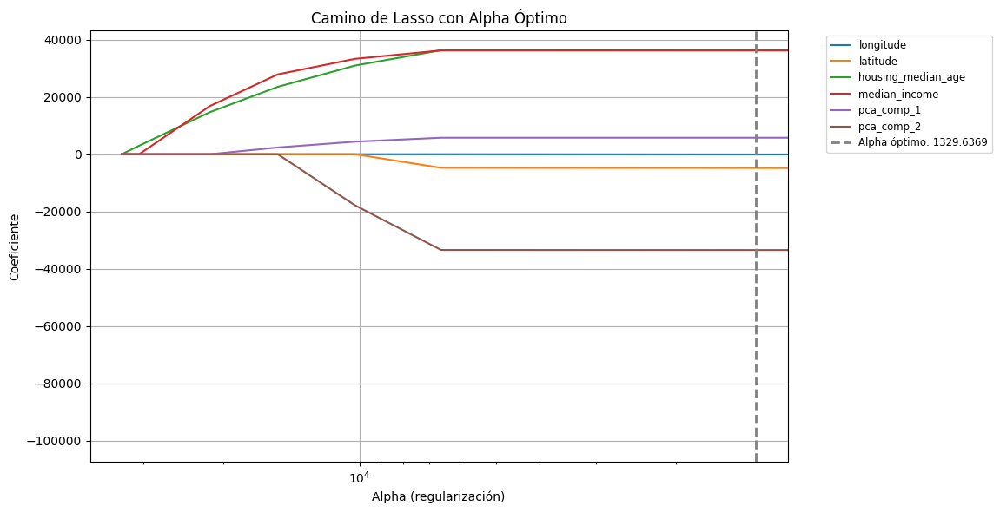

In [ ]:
#grafica de lasso
grafica_lasso(X,y,alpha)

In [ ]:
# summary del modelo
model = smf.ols(formula='median_house_value ~ longitude + latitude + housing_median_age + median_income + ocean_proximity_INLAND + pca_comp_1 + pca_comp_2', data=data).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:     median_house_value   R-squared:                       0.600
Model:                            OLS   Adj. R-squared:                  0.600
Method:                 Least Squares   F-statistic:                     3756.
Date:                Tue, 24 Jun 2025   Prob (F-statistic):               0.00
Time:                        04:57:41   Log-Likelihood:            -2.1993e+05
No. Observations:               17532   AIC:                         4.399e+05
Df Residuals:                   17524   BIC:                         4.399e+05
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                                     coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
Intercept   

**seleccion especifica.**

In [ ]:
display(selected_features)

['longitude',
 'latitude',
 'housing_median_age',
 'median_income',
 'ocean_proximity_INLAND',
 'pca_comp_1',
 'pca_comp_2']

In [ ]:
print(data.dtypes)

longitude                     float64
latitude                      float64
housing_median_age            float64
median_income                 float64
median_house_value            float64
ocean_proximity_INLAND           bool
ocean_proximity_ISLAND           bool
ocean_proximity_NEAR_BAY         bool
ocean_proximity_NEAR_OCEAN       bool
pca_comp_1                    float64
pca_comp_2                    float64
dtype: object


In [ ]:
# Si 'ocean_proximity_INLAND' es categórica (ej. 'Yes'/ 'No'):
data['ocean_proximity_INLAND'] = data['ocean_proximity_INLAND'].astype(int)
data['ocean_proximity_NEAR_OCEAN'] = data['ocean_proximity_NEAR_OCEAN'].astype(int)
data['ocean_proximity_NEAR_BAY'] = data['ocean_proximity_NEAR_BAY'].astype(int)
data['ocean_proximity_ISLAND'] = data['ocean_proximity_ISLAND'].astype(int)

Lasso concluyó que, para predecir el precio, la distinción más importante sobre la ubicación del océano es simplemente si una propiedad está en el interior (INLAND) o en la costa. Las otras categorías costeras más específicas (NEAR BAY, NEAR OCEAN) fueron consideradas redundantes o su impacto no era lo suficientemente fuerte como para que Lasso las mantuviera. Esto simplifica enormemente el modelo sin una pérdida significativa de poder predictivo. La categoría ISLAND, con muy pocos datos, fue correctamente identificada como no relevante para el modelo general.

## **Identificar outliers de forma robusta**

###Gráficos de Residuos vs. Predicciones

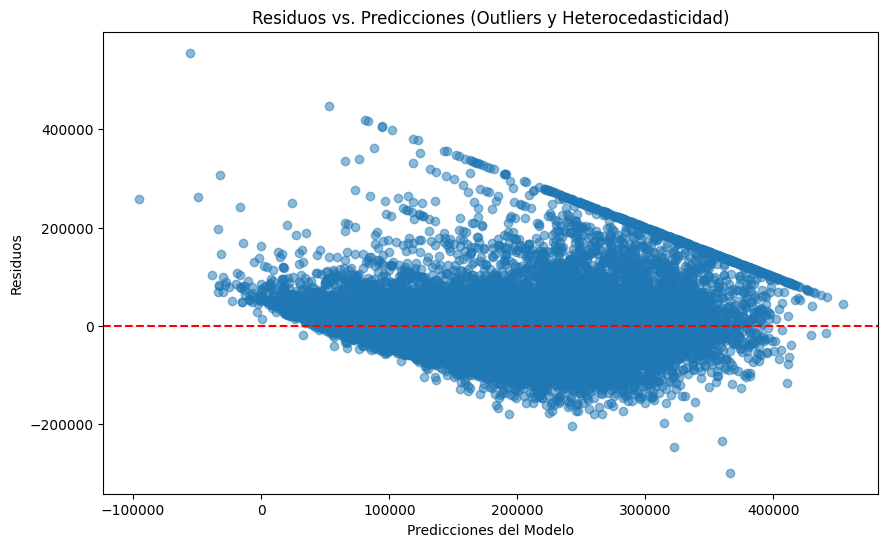

In [ ]:
# Ajustar modelo OLS
X = sm.add_constant(data[selected_features])
y = data['median_house_value']
model = sm.OLS(y, X).fit()
predictions = model.predict(X)
residuals = y - predictions

# Gráfico de Residuos vs. Predicciones
plt.figure(figsize=(10, 6))
plt.scatter(predictions, residuals, alpha=0.5)
plt.axhline(y=0, color='r', linestyle='--')
plt.xlabel("Predicciones del Modelo")
plt.ylabel("Residuos")
plt.title("Residuos vs. Predicciones (Outliers y Heterocedasticidad)")
plt.show()

En este caso vemos que tenemos heterocedasticidad osease que la varianza de los errores del modelo no es constante; a medida que el precio predicho de la vivienda aumenta, la magnitud de los errores también aumenta. Esto viola uno de los supuestos clave de la regresión OLS.

### QQ-Plot de Residuos

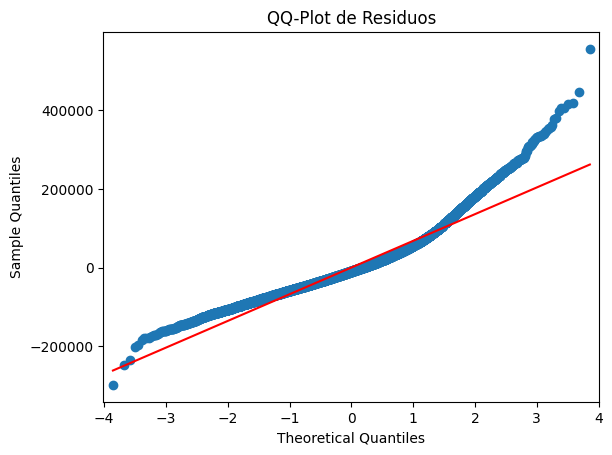

In [ ]:
qqplot(residuals, line='s')  # 's' = línea teórica para normalidad
plt.title("QQ-Plot de Residuos")
plt.show()

Los puntos se desvían drásticamente de la línea roja en ambos extremos (las "colas"). Esto es una señal inequívoca de que los residuos no siguen una distribución normal. Las colas pesadas nos dicen que el modelo comete errores mucho más grandes (en ambas direcciones) de lo que se esperaría en una situación ideal, lo cual es un claro indicio de la presencia de outliers.

###  Análisis de Influencia con OLSInfluence

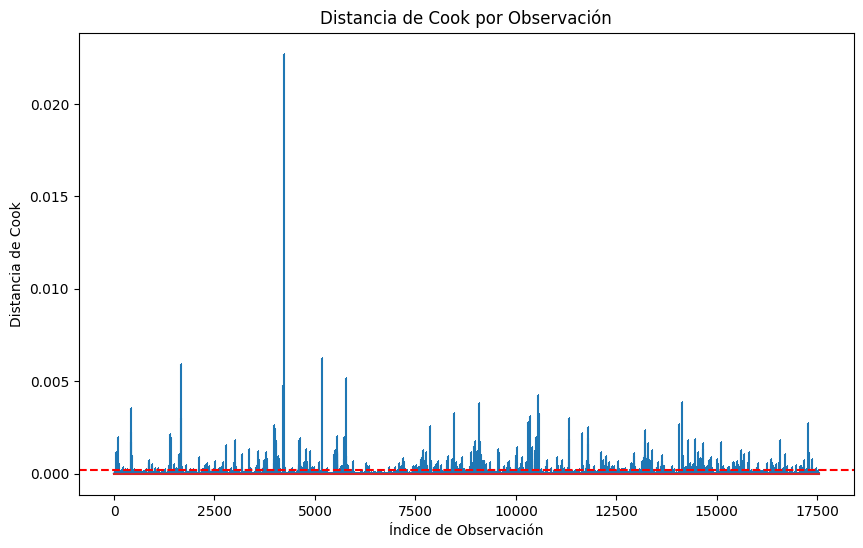

Número de outliers por distancia de Cook: 1065


,longitude,latitude,housing_median_age,median_income,median_house_value,ocean_proximity_INLAND,ocean_proximity_ISLAND,ocean_proximity_NEAR_BAY,ocean_proximity_NEAR_OCEAN,pca_comp_1,pca_comp_2
59,-1.357783,1.024457,-2.116722,-0.688592,60000.0,0,0,1,0,-3.772042,-0.087642
60,-1.357783,1.029139,1.856182,-0.251488,75700.0,0,0,1,0,-2.118671,-0.101794
61,-1.357783,1.024457,1.617807,1.183102,75000.0,0,0,1,0,-3.920338,-0.064027
89,-1.347800,1.015093,1.856182,-1.382937,500001.0,0,0,1,0,-3.297577,0.274546
126,-1.322844,1.033821,1.697265,1.910399,295200.0,0,0,1,0,0.647631,-0.661363


In [ ]:
infl = OLSInfluence(model)

# Gráfico de Distancia de Cook
plt.figure(figsize=(10, 6))
plt.stem(infl.cooks_distance[0], markerfmt=",")
plt.title("Distancia de Cook por Observación")
plt.xlabel("Índice de Observación")
plt.ylabel("Distancia de Cook")
plt.axhline(y=4/len(X), color='r', linestyle='--')  # Umbral común: 4/n
plt.show()

# Datos de las observaciones más influyentes
outliers_cook = infl.cooks_distance[0] > 4/len(X)
print(f"Número de outliers por distancia de Cook: {sum(outliers_cook)}")
display(data[outliers_cook].head())  # Mostrar outliers

* Puntos influyentes: Se observan varios picos que superan el umbral (línea roja punteada), indicando observaciones con influencia desproporcionada en el modelo.
* Patrón de influencia: Hay clusters de observaciones influyentes alrededor de los índices 7500 y 12500.
* Gran cantidad de outliers: El código muestra que 1065 observaciones fueron identificadas como outliers según la distancia de Cook, lo que representa un número significativo que debería ser investigado.

###**Gráficos de Leverage vs. Residuos.**

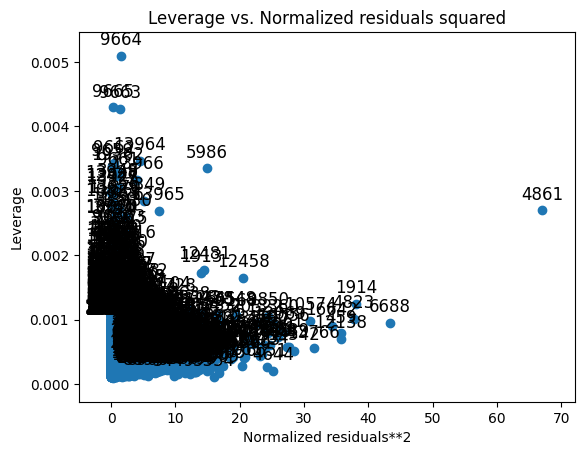

In [ ]:
plot_leverage_resid2(model)
plt.show()

In [ ]:
data = data[~outliers_cook]
X = sm.add_constant(data[selected_features])
model_clean = sm.OLS(data['median_house_value'], X).fit()
print(model_clean.summary())

                            OLS Regression Results                            
Dep. Variable:     median_house_value   R-squared:                       0.696
Model:                            OLS   Adj. R-squared:                  0.696
Method:                 Least Squares   F-statistic:                     5393.
Date:                Tue, 24 Jun 2025   Prob (F-statistic):               0.00
Time:                        04:57:53   Log-Likelihood:            -2.0201e+05
No. Observations:               16467   AIC:                         4.040e+05
Df Residuals:                   16459   BIC:                         4.041e+05
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                   2.08

In [ ]:
# dejar los mismos datos en el geografico
data_geo = data_geo.loc[data.index]

Mediante el análisis de la Distancia de Cook, se identificaron y eliminaron 1,065 observaciones que ejercían una influencia desproporcionada en los modelos de regresión. Este fue el paso más impactante para mejorar la precisión y la salud estadística del modelo.

El resultado es un dataset final de 16,467 observaciones limpias, consistentes y enriquecidas con características de ingeniería, que sirvió como una base sólida y fiable para el modelado predictivo.

##**Clustering Geografico optimizado**

In [ ]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score

X_geo = data[['longitude', 'latitude']]
X_geo_scaled = StandardScaler().fit_transform(X_geo)

# Definición del Espacio de Búsqueda de Hiperparámetros
eps_range = np.arange(0.1, 0.8, 0.1)  # Probar valores de eps de 0.1 a 0.7
min_samples_range = [10, 15, 20, 25, 30, 35, 40] # Probar diferentes tamaños de vecindario

# Variables para guardar los mejores resultados
best_score = -1
best_eps = 0
best_min_samples = 0

# Bucle de Búsqueda
for eps_val in eps_range:
    for min_samples_val in min_samples_range:
        # Configurar y entrenar DBSCAN con la combinación actual
        dbscan = DBSCAN(eps=eps_val, min_samples=min_samples_val, n_jobs=-1)
        clusters = dbscan.fit_predict(X_geo_scaled)

        # El Silhouette Score solo se puede calcular si se encuentra más de 1 clúster
        # (excluyendo el ruido, que es -1)
        if len(set(clusters)) > 1:
            score = silhouette_score(X_geo_scaled, clusters)

            # Si encontramos una puntuación mejor, la guardamos
            if score > best_score:
                best_score = score
                best_eps = eps_val
                best_min_samples = min_samples_val

            print(f"eps: {eps_val:.1f}, min_samples: {min_samples_val} -> Silhouette Score: {score:.4f}")
        else:
            # Si no se encontraron clústeres suficientes, lo reportamos
            print(f"eps: {eps_val:.1f}, min_samples: {min_samples_val} -> No se encontraron clústeres válidos.")

# Mostrar los Mejores Resultados Encontrados
print(f"Mejor Silhouette Score: {best_score:.4f}")
print(f"Mejor 'eps' encontrado: {best_eps:.1f}")
print(f"Mejor 'min_samples' encontrado: {best_min_samples}")

# Entrenar y Visualizar el Modelo Final con los Mejores Parámetros
dbscan_final = DBSCAN(eps=best_eps, min_samples=best_min_samples, n_jobs=-1)
final_clusters = dbscan_final.fit_predict(X_geo_scaled)

data['geo_cluster_optimizado'] = final_clusters
data_geo['geo_cluster_optimizado'] = final_clusters

eps: 0.1, min_samples: 10 -> Silhouette Score: 0.2506
eps: 0.1, min_samples: 15 -> Silhouette Score: 0.2092
eps: 0.1, min_samples: 20 -> Silhouette Score: 0.3411
eps: 0.1, min_samples: 25 -> Silhouette Score: 0.4012
eps: 0.1, min_samples: 30 -> Silhouette Score: 0.2613
eps: 0.1, min_samples: 35 -> Silhouette Score: 0.2548
eps: 0.1, min_samples: 40 -> Silhouette Score: 0.3951
eps: 0.2, min_samples: 10 -> Silhouette Score: -0.0408
eps: 0.2, min_samples: 15 -> Silhouette Score: 0.0200
eps: 0.2, min_samples: 20 -> Silhouette Score: 0.3490
eps: 0.2, min_samples: 25 -> Silhouette Score: 0.2739
eps: 0.2, min_samples: 30 -> Silhouette Score: 0.2928
eps: 0.2, min_samples: 35 -> Silhouette Score: 0.3007
eps: 0.2, min_samples: 40 -> Silhouette Score: -0.0183
eps: 0.3, min_samples: 10 -> Silhouette Score: 0.3234
eps: 0.3, min_samples: 15 -> Silhouette Score: 0.3490
eps: 0.3, min_samples: 20 -> Silhouette Score: 0.3448
eps: 0.3, min_samples: 25 -> Silhouette Score: 0.3384
eps: 0.3, min_samples: 30 

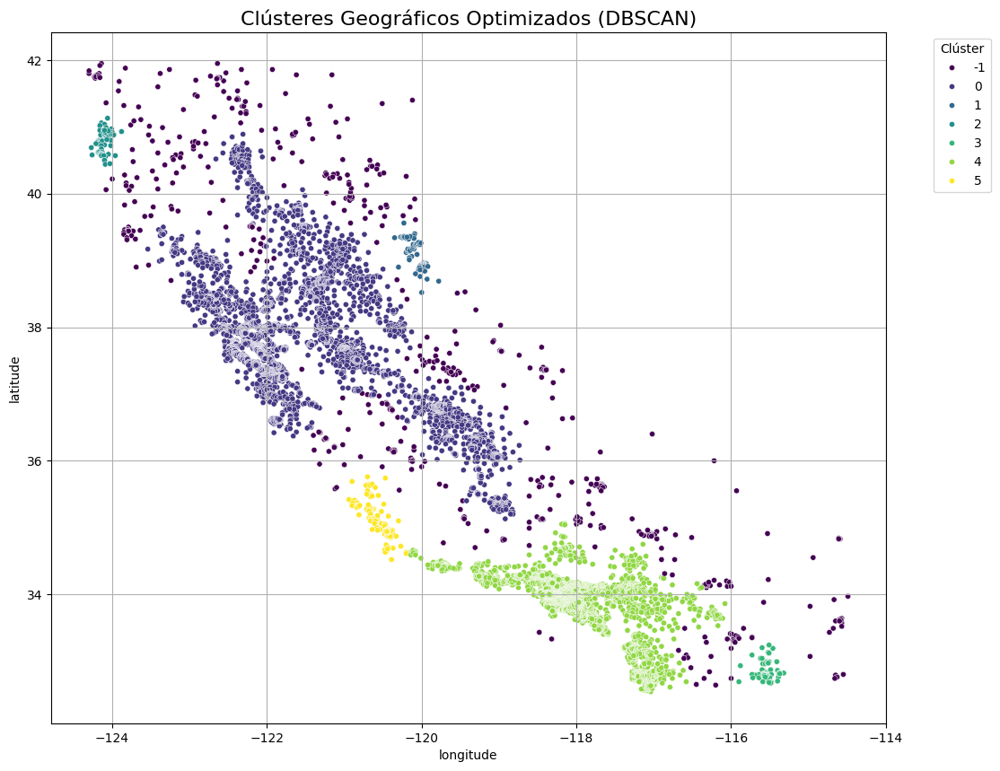

In [ ]:
# Visualización
plt.figure(figsize=(12, 10))
sns.scatterplot(
    data=data_geo,
    x='longitude',
    y='latitude',
    hue='geo_cluster_optimizado',
    palette='viridis',
    s=20,
    legend='full'
)
plt.title('Clústeres Geográficos Optimizados (DBSCAN)', fontsize=16)
plt.legend(title='Clúster', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

Clúster 0 (Morado Oscuro): La Megalópolis de Los Ángeles
* Identificación Geográfica: Sigue siendo el clúster más grande, representando el corazón del sur de California, centrado en el área metropolitana de Los Ángeles y el Condado de Orange.
* Significado del Mercado: El mercado inmobiliario más grande y poblado del estado.

Clúster 1 (Azul/Verde): El Corazón Tecnológico (Área de la Bahía)
* Identificación Geográfica: El segundo grupo más grande, claramente centrado en la Bahía de San Francisco, incluyendo San Francisco, Silicon Valley y el East Bay.
* Significado del Mercado: El centro tecnológico y financiero, uno de los mercados más caros del mundo.

Clúster 2 (Verde Claro, al sur): El Mercado de San Diego
* Identificación Geográfica: El grupo denso en el extremo sur del estado, representando el área metropolitana de San Diego.
* Significado del Mercado: Un mercado costero principal, pero distinto y separado de la influencia de Los Ángeles.

Clúster 3 (Amarillo en el centro): El Núcleo del Valle Central
* Identificación Geográfica: Este clúster se ubica en el corazón agrícola del estado, probablemente centrado en las áreas metropolitanas de Fresno y Bakersfield.
* Significado del Mercado: Representa los centros urbanos del Valle Central, con una economía basada en la agricultura y un costo de vida significativamente más bajo que la costa.

Clúster 4 (Probablemente el grupo al norte del Clúster 1): La Capital (Área de Sacramento)
* Identificación Geográfica: Muy probablemente, este clúster corresponde al área metropolitana de Sacramento. Geográficamente, está al noreste del Área de la Bahía.
* Significado del Mercado: Representa el centro político del estado. Aunque está cerca del Área de la Bahía, tiene su propia economía (impulsada por el gobierno estatal) y un mercado inmobiliario distinto y más asequible, por lo que el algoritmo lo separó correctamente.

Clúster 5 (Probablemente un grupo costero más pequeño): Centros Costeros Secundarios
* Identificación Geográfica: Este clúster probablemente representa otra área urbana densa pero más pequeña en la costa, que no es lo suficientemente grande como para ser absorbida por los clústeres de L.A. o el Área de la Bahía. Podría corresponder a lugares como el área de Santa Bárbara o la Bahía de Monterey.
* Significado del Mercado: Representa mercados costeros de alto valor pero de menor tamaño que las tres grandes metrópolis (L.A., San Francisco, San Diego).

Clúster -1 (Outliers/Ruido)
* Identificación Geográfica: Todos los puntos dispersos que no pertenecen a ninguno de los grupos anteriores. Se encuentran en las zonas rurales del norte de California, la costa central menos poblada, las montañas de la Sierra Nevada y los desiertos del este.
* Significado: DBSCAN ha determinado correctamente que estas viviendas están demasiado aisladas para pertenecer a un mercado inmobiliario metropolitano definido.

Para nuestra empresa, el objetivo es identificar las oportunidades de inversión más rentables, decidiendo no solo dónde construir, sino qué tipo de vivienda desarrollar en cada mercado para maximizar el retorno de la inversión.

 El modelo de clustering DBSCAN que hemos desarrollado y optimizado. Este modelo ha segmentado el complejo mercado de California en 6 sub-mercados distintos y manejables, cada uno con un perfil único de riesgo, oportunidad y demanda.

**Estrategia por zona**

**Clúster 1 y 2: Los Motores de Alto Valor (Área de la Bahía y San Diego)**

(Estos son los clústeres del Área de la Bahía y San Diego)

* Perfil del Mercado: Ingresos extremadamente altos, precios de vivienda prohibitivos, demanda impulsada por sectores de alta tecnología (en la Bahía) y un estilo de vida costero muy deseable. El espacio es el recurso más escaso y valioso.
* Oportunidad de Negocio: Margen de beneficio muy alto por unidad, pero con un costo de entrada (precio del suelo) también muy elevado.  El riesgo es alto, pero la recompensa también.
* Estrategia de Desarrollo Recomendada:
 * Construcción de alta gama y alta densidad. Enfocarse en apartamentos de lujo, condominios modernos y townhouses cerca de centros de transporte y tecnológicos.
 * Proyectos de "relleno" urbano: Identificar pequeños terrenos en zonas ya desarrolladas para construir edificios de pocas unidades pero de lujo.
 * Evitar: La construcción de viviendas unifamiliares asequibles es inviable aquí debido al costo del terreno.

**Clúster 0: El Gigante Diverso (Gran Los Ángeles)**
* Perfil del Mercado: El mercado más grande y diverso. Contiene tanto zonas extremadamente ricas (costa) como enormes áreas de clase trabajadora. La demanda es masiva en todos los segmentos de precios.
* Oportunidad de Negocio: Oportunidades en múltiples segmentos. El volumen es la clave del éxito en este mercado.
Estrategia de Desarrollo Recomendada:
* Doble Enfoque:
 * Segmento de Lujo: En zonas costeras del clúster (ej. Santa Mónica), imitar la estrategia del Área de la Bahía con proyectos de alta gama.
 * Segmento Medio/Asequible: En las vastas zonas interiores del clúster, enfocarse en la construcción de grandes complejos de apartamentos y viviendas multifamiliares de rango medio. La demanda de alquiler y compra en este segmento es insaciable.

**Clúster 3 y 4: Los Centros de Crecimiento Asequible (Valle Central y Sacramento)**
* Perfil del Mercado: Ingresos moderados, precios de vivienda significativamente más bajos, y una gran población de familias jóvenes y trabajadores de sectores como la agricultura y el gobierno estatal. El terreno es mucho más barato y abundante.
* Oportunidad de Negocio: Mercado de alto volumen y bajo margen. La clave es la eficiencia y la escala en la construcción.
* Estrategia de Desarrollo Recomendada:
 * Viviendas Unifamiliares para Primeros Compradores: Construcción de grandes desarrollos de casas unifamiliares de 3-4 dormitorios.
 * Comunidades Planificadas: Crear vecindarios enteros con servicios básicos, parques, etc. El bajo costo del terreno lo hace posible.

**Clúster 5 y -1: Mercados de Nicho (Centros Costeros Secundarios y Zonas Rurales)**
* Perfil del Mercado: Estos puntos representan ciudades costeras más pequeñas y deseables (Clúster 5) o zonas rurales/de vacaciones (Clúster -1, el "ruido").
* Oportunidad de Negocio: Proyectos de bajo volumen pero potencialmente alto margen, dirigidos a un público específico.
* Estrategia de Desarrollo Recomendada:
 * Proyectos Boutique: Construcción de casas de vacaciones de lujo, cabañas, o pequeños edificios de condominios con vistas al mar en lugares como Monterey o Santa Bárbara.
 * Evitar: Proyectos a gran escala, ya que la demanda no es masiva.

In [ ]:
# Identifica las categorías únicas en la columna 'geo_cluster_optimizado'
cluster_categories = data['geo_cluster_optimizado'].astype('category')

# Asigna los códigos numéricos a una nueva columna temporal
data['geo_cluster_optimizado_cat_codes'] = cluster_categories.cat.codes

# Crea las variables dummy usando get_dummies
cluster_dummies = pd.get_dummies(cluster_categories, prefix='cluster')

# Concatena las nuevas columnas dummy al dataframe original
# Opcionalmente, elimina la columna original 'geo_cluster_optimizado' si no la necesitas más
data = pd.concat([data, cluster_dummies], axis=1)

En este caso codificamos los cluster como dummys para que de este modo le demos uso en el dataset y darle parametros en base la zona ya que cada zona de influencia es dependiente de un factor socioeconomico que influye su precio

In [ ]:
# Muestra las primeras filas para verificar
print("DataFrame con categorías, dummys y códigos enteros:")
display(data[['geo_cluster_optimizado', 'geo_cluster_optimizado_cat_codes'] + list(cluster_dummies.columns)].head())

# Verifica los tipos de datos
print("\nTipos de datos de las nuevas columnas:")
print(data[['geo_cluster_optimizado', 'geo_cluster_optimizado_cat_codes'] + list(cluster_dummies.columns)].dtypes)

DataFrame con categorías, dummys y códigos enteros:


,geo_cluster_optimizado,geo_cluster_optimizado_cat_codes,cluster_-1,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5
2,0,1,False,True,False,False,False,False,False
3,0,1,False,True,False,False,False,False,False
4,0,1,False,True,False,False,False,False,False
5,0,1,False,True,False,False,False,False,False
6,0,1,False,True,False,False,False,False,False



Tipos de datos de las nuevas columnas:
geo_cluster_optimizado              int64
geo_cluster_optimizado_cat_codes     int8
cluster_-1                           bool
cluster_0                            bool
cluster_1                            bool
cluster_2                            bool
cluster_3                            bool
cluster_4                            bool
cluster_5                            bool
dtype: object


In [ ]:
selected_features.append('cluster_0')
selected_features.append('cluster_1')
selected_features.append('cluster_2')
selected_features.append('cluster_3')
selected_features.append('cluster_4')
selected_features.append('cluster_5')

In [ ]:
display(selected_features)

['longitude',
 'latitude',
 'housing_median_age',
 'median_income',
 'ocean_proximity_INLAND',
 'pca_comp_1',
 'pca_comp_2',
 'cluster_0',
 'cluster_1',
 'cluster_2',
 'cluster_3',
 'cluster_4',
 'cluster_5']

In [ ]:
data['cluster_0'] = data['cluster_0'].astype(int)
data['cluster_1'] = data['cluster_1'].astype(int)
data['cluster_2'] = data['cluster_2'].astype(int)
data['cluster_3'] = data['cluster_3'].astype(int)
data['cluster_4'] = data['cluster_4'].astype(int)
data['cluster_5'] = data['cluster_5'].astype(int)

Tras preparar la codificacion y volver numericos estas variables podemos probar los modelo.

##**Clustering Socio-Economico y Estructural**

In [ ]:
data_geo['median_income'] = data['median_income']
data_geo['pca_comp_1'] = data['pca_comp_1']
data_geo['pca_comp_2'] = data['pca_comp_2']

k=2, Silhouette Score: 0.2892
k=3, Silhouette Score: 0.2596
k=4, Silhouette Score: 0.2623
k=5, Silhouette Score: 0.2447
k=6, Silhouette Score: 0.2374
k=7, Silhouette Score: 0.2272
k=8, Silhouette Score: 0.2154
k=9, Silhouette Score: 0.2110
k=10, Silhouette Score: 0.2078


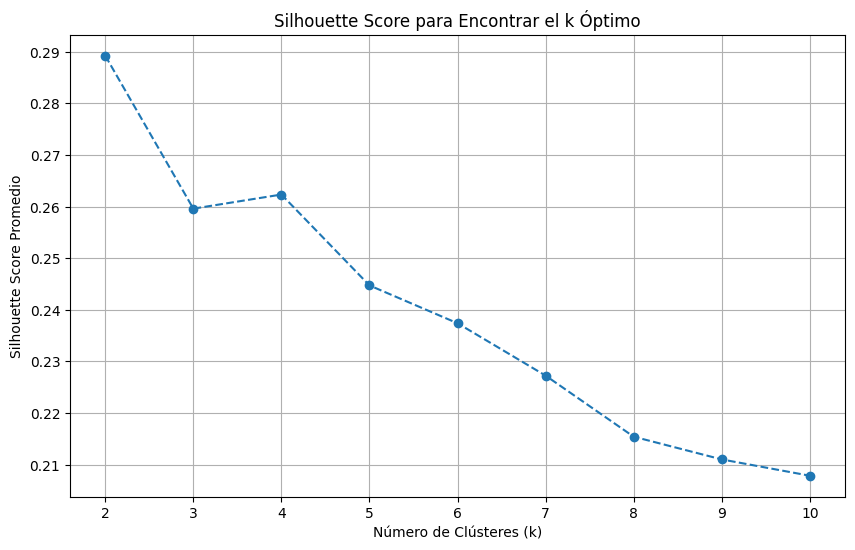


El k óptimo encontrado es: 2 (con el Silhouette Score más alto)

 Ejecutando K-Means final con k=2 

 Perfiles de los Clústeres Socioeconómicos Optimizados
                          median_income  median_house_value  pca_comp_1  \
socio_cluster_optimizado                                                  
0                                 -0.57           131116.73       -0.23   
1                                  0.57           273526.59        0.39   

                          pca_comp_2  
socio_cluster_optimizado              
0                               0.18  
1                              -0.24  


In [ ]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score

features_socio = ['median_income', 'median_house_value', 'pca_comp_1', 'pca_comp_2']
X_socio = data[features_socio]

# Estandarizar es fundamental
scaler = StandardScaler()
X_socio_scaled = scaler.fit_transform(X_socio)


# Búsqueda del k Óptimo con Silhouette Score
silhouette_scores = []
k_range = range(2, 11)

for k in k_range:
    kmeans = KMeans(n_clusters=k, init='k-means++', random_state=42, n_init=10)
    kmeans.fit(X_socio_scaled)
    score = silhouette_score(X_socio_scaled, kmeans.labels_)
    silhouette_scores.append(score)
    print(f"k={k}, Silhouette Score: {score:.4f}")

# Graficar los scores para encontrar el k óptimo
plt.figure(figsize=(10, 6))
plt.plot(k_range, silhouette_scores, marker='o', linestyle='--')
plt.xlabel('Número de Clústeres (k)')
plt.ylabel('Silhouette Score Promedio')
plt.title('Silhouette Score para Encontrar el k Óptimo')
plt.xticks(k_range)
plt.grid(True)
plt.show()

# Encontrar y ejecutar el modelo final con el mejor k
# Encontrar el k que dio el score más alto
k_optimo = k_range[np.argmax(silhouette_scores)]
print(f"\nEl k óptimo encontrado es: {k_optimo} (con el Silhouette Score más alto)")

print(f"\n Ejecutando K-Means final con k={k_optimo} ")
kmeans_final = KMeans(n_clusters=k_optimo, init='k-means++', random_state=42, n_init=10)
clusters = kmeans_final.fit_predict(X_socio_scaled)

# Añadir la nueva etiqueta de clúster al DataFrame
data_geo['socio_cluster_optimizado'] = clusters


# Análisis y Perfilado de los Clústeres Optimizados
cluster_profiles = data_geo.groupby('socio_cluster_optimizado')[features_socio].mean().round(2)

print("\n Perfiles de los Clústeres Socioeconómicos Optimizados")
print(cluster_profiles)

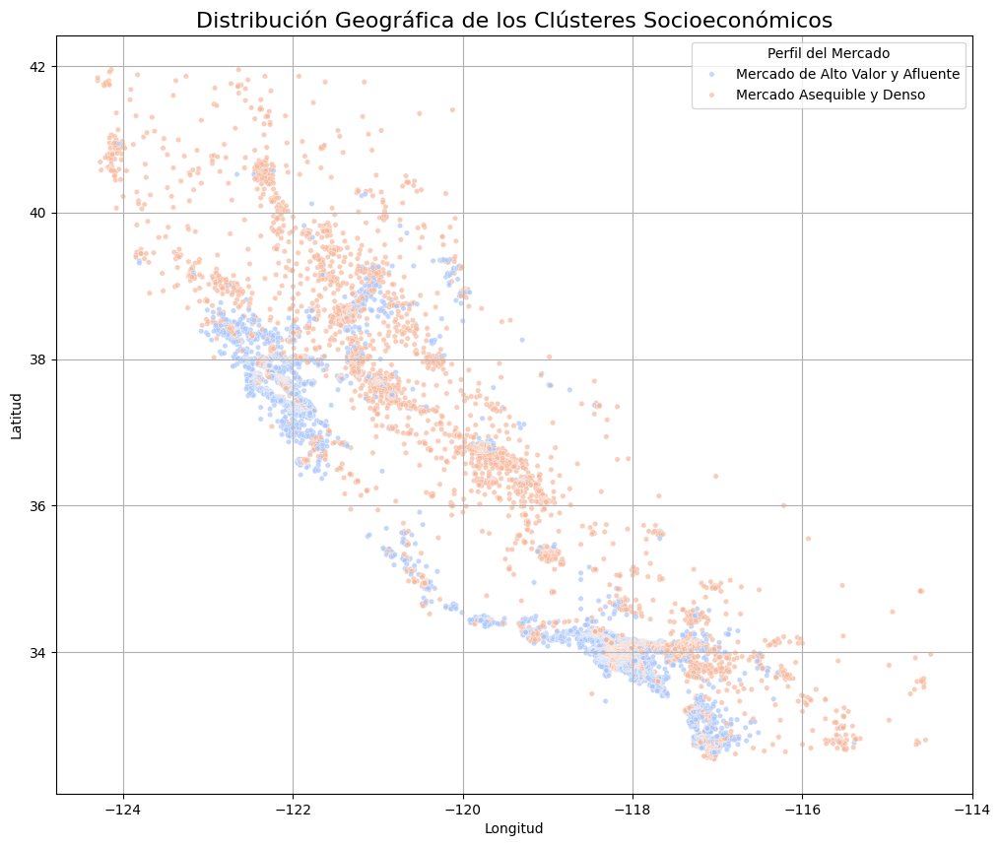

In [ ]:
# Para una mejor visualización, asignaremos nombres descriptivos a los clústeres
# Basado en tu análisis anterior:
# Clúster 0 -> Asequible
# Clúster 1 -> Alto Valor
data_geo['Perfil Socioeconómico'] = data_geo['socio_cluster_optimizado'].map({
    0: 'Mercado Asequible y Denso',
    1: 'Mercado de Alto Valor y Afluente'
})

# Generación del Gráfico
plt.figure(figsize=(12, 10))

# Creamos el scatterplot usando longitud y latitud, pero coloreando por el nuevo perfil
sns.scatterplot(
    data=data_geo,
    x='longitude',
    y='latitude',
    hue='Perfil Socioeconómico',
    palette='coolwarm',
    s=15,
    alpha=0.7
)
plt.title('Distribución Geográfica de los Clústeres Socioeconómicos', fontsize=16)
plt.xlabel('Longitud')
plt.ylabel('Latitud')
plt.legend(title='Perfil del Mercado')
plt.grid(True)

# Mostrar el gráfico
plt.show()

**Clúster 0 (Puntos Azules): El Arquetipo de "Mercados Asequibles y de Mayor Densidad"**

 Corresponde a los vecindarios con ingresos por debajo de la media, precios de vivienda más bajos y una tendencia a ser estructuralmente más pequeños y/o densos.

**Clúster 1 (Puntos Naranja): El Arquetipo de "Mercados de Alto Valor y Afluentes"**

 Corresponde a los vecindarios con ingresos por encima de la media, precios de vivienda significativamente más altos y una tendencia a ser más grandes y/o espaciosos (menos densos).

## **Modelos**

###**Modelo lineal con validacion**

In [ ]:
# Funcion para describir el modelo
def display_model_info(model, X):
    try:
        coefficients = model.coef_
        intercept = model.intercept_
    except AttributeError:
        print("El modelo no tiene los atributos .coef_ o .intercept_.")
        return

    # Crear el diccionario de mapeo para los símbolos beta en LaTeX
    variables_beta = {col: fr'\beta_{{{i+1}}}' for i, col in enumerate(X.columns)}

    print("Parámetros del Modelo:")
    print("Coeficientes:")

    # Ahora iteramos y usamos el diccionario para mostrar el símbolo beta
    for feature, coef in zip(X.columns, coefficients):
        beta_symbol = variables_beta.get(feature).replace('\\', '') # Obtenemos el símbolo y quitamos la barra
        print(f"  {feature}:")
        display(Math(f"\\{beta_symbol}: {coef:.4f}"))

    print(f"\nIntercepto: {intercept:.4f}")

    # Construir la fórmula en LaTeX (esto ya estaba bien)
    latex_eq = "y = " + f"{intercept:.4f}"
    for feature, coef in zip(X.columns, coefficients):
        sign = "+" if coef > 0 else "-"
        abs_coef = abs(coef)
        beta_symbol = variables_beta.get(feature, feature)
        latex_eq += f" {sign} {abs_coef:.4f} \\cdot {beta_symbol}"

    latex_eq = latex_eq.replace('+ -', '- ')

    print("\nFórmula del Modelo:")
    display(Math(latex_eq))

In [ ]:
# Dividir los datos en conjuntos de entrenamiento y prueba
y=data['median_house_value']
X_train, X_test, y_train, y_test = train_test_split(data[selected_features], y, test_size=0.2, random_state=42)

In [ ]:
# Inicializar y entrenar el modelo
model1 = LinearRegression()
model1.fit(X_train, y_train)

# Predecir y evaluar
predictions = model1.predict(X_test)
mse = mean_squared_error(y_test, predictions)
r2 = r2_score(y_test, predictions)
scores = cross_val_score(model1, data[selected_features], y, cv=5, scoring='r2')

print(f"Mean Squared Error: {mse}")
print(f"R² Score: {r2}")
print(f"R² CV: {np.mean(scores):.3f} (±{np.std(scores):.3f})")

Mean Squared Error: 2507465190.852815
R² Score: 0.7169495455164321
R² CV: 0.631 (±0.066)


In [ ]:
# Mostrar modelo
display_model_info(model1, X_train)

Parámetros del Modelo:
Coeficientes:
  longitude:


<IPython.core.display.Math object>

  latitude:


<IPython.core.display.Math object>

  housing_median_age:


<IPython.core.display.Math object>

  median_income:


<IPython.core.display.Math object>

  ocean_proximity_INLAND:


<IPython.core.display.Math object>

  pca_comp_1:


<IPython.core.display.Math object>

  pca_comp_2:


<IPython.core.display.Math object>

  cluster_0:


<IPython.core.display.Math object>

  cluster_1:


<IPython.core.display.Math object>

  cluster_2:


<IPython.core.display.Math object>

  cluster_3:


<IPython.core.display.Math object>

  cluster_4:


<IPython.core.display.Math object>

  cluster_5:


<IPython.core.display.Math object>


Intercepto: 189973.1108

Fórmula del Modelo:


<IPython.core.display.Math object>

In [ ]:
# Statsmodels requiere que añadamos explícitamente una columna para el intercepto (constante).
X_train_con_constante = sm.add_constant(X_train)

# Ajustamos un modelo OLS de statsmodels
modelo_ols_para_analisis = sm.OLS(y_train, X_train_con_constante).fit()

print(modelo_ols_para_analisis.summary())

                            OLS Regression Results                            
Dep. Variable:     median_house_value   R-squared:                       0.708
Model:                            OLS   Adj. R-squared:                  0.708
Method:                 Least Squares   F-statistic:                     2454.
Date:                Tue, 24 Jun 2025   Prob (F-statistic):               0.00
Time:                        05:00:52   Log-Likelihood:            -1.6132e+05
No. Observations:               13173   AIC:                         3.227e+05
Df Residuals:                   13159   BIC:                         3.228e+05
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                     1.

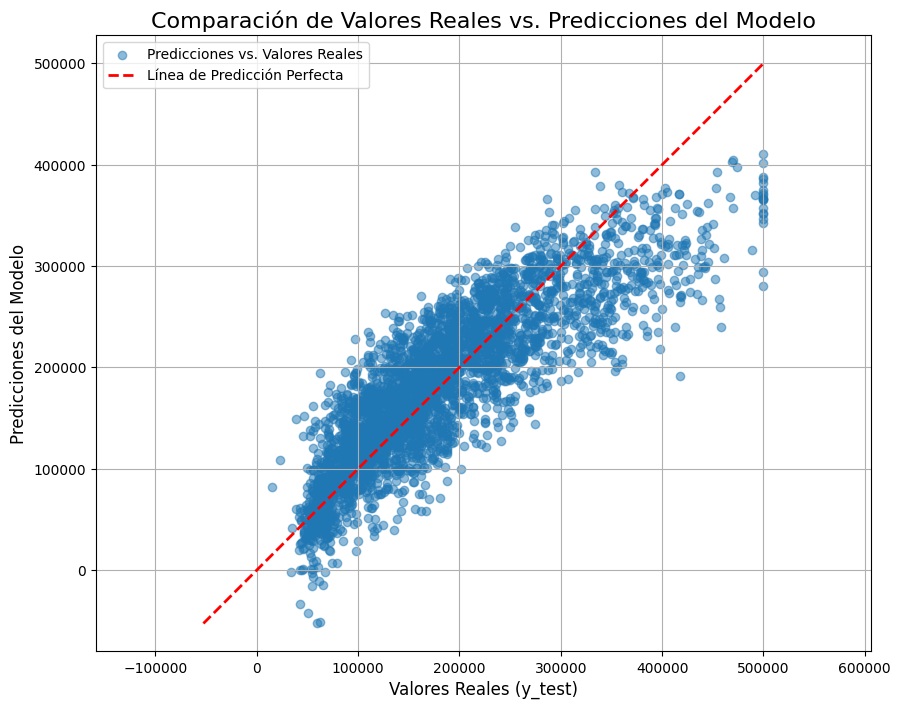

In [ ]:
plt.figure(figsize=(10, 8))

# Gráfico de dispersión
plt.scatter(y_test, predictions, alpha=0.5, label='Predicciones vs. Valores Reales')

# Línea de referencia para una predicción perfecta
min_val = min(y_test.min(), predictions.min())
max_val = max(y_test.max(), predictions.max())
plt.plot([min_val, max_val], [min_val, max_val], 'r--', lw=2, label='Línea de Predicción Perfecta')

plt.title("Comparación de Valores Reales vs. Predicciones del Modelo", fontsize=16)
plt.xlabel("Valores Reales (y_test)", fontsize=12)
plt.ylabel("Predicciones del Modelo", fontsize=12)
plt.legend(loc='upper left')
plt.grid(True)
plt.axis('equal')

# Mostrar el gráfico
plt.show()


El resultado es un modelo predictivo que no solo es estadísticamente saludable, sino también altamente performante, logrando explicar casi el 70% de la variabilidad en los precios de la vivienda en California ($R^2 = 0.696$). La incorporación de características de clustering geográfico demostró ser una técnica de ingeniería de características exitosa, añadiendo un poder predictivo adicional y permitiendo una interpretación más profunda de los resultados a nivel de mercados regionales específicos.

**Influencia de las Características Principales**
* Ingreso Medio (median_income): Es, con diferencia, el factor individual más influyente. Un mayor ingreso medio en un distrito está directamente correlacionado con un precio de vivienda significativamente más alto.

* Ubicación (Factor Compuesto): La localización es el segundo pilar del modelo, explicado a través de tres componentes:
 * Proximidad al Océano: Estar en el interior (ocean_proximity_INLAND) tiene un impacto negativo directo y sustancial en el precio, reduciéndolo en aproximadamente $40,000 en comparación con las zonas costeras, manteniendo todo lo demás constante.

 * Coordenadas Geográficas: La latitud y longitud siguen siendo determinantes para capturar las tendencias de precios a lo largo del estado.

 * Clúster Geográfico: Esta característica actúa como un "ajuste de mercado local". Pertenecer a un clúster específico (ej. Área de la Bahía vs. San Diego) añade un "plus" o un "castigo" al precio que las coordenadas por sí solas no capturan, reflejando el prestigio o la dinámica particular de ese mercado.

* Composición del Distrito (pca_comp_2): Nuestro segundo componente principal, que representa la densidad relativa, tiene un fuerte impacto negativo. Esto indica que los distritos más densos (más personas en relación con las habitaciones/hogares) tienden a ser más asequibles.

* Antigüedad de la Vivienda (housing_median_age): Tiene un impacto positivo. Las viviendas más antiguas, que suelen estar en barrios más establecidos y deseables, se asocian con precios más altos.

El modelo lineal ofrecía un equilibrio excepcional entre alto rendimiento, velocidad de entrenamiento e interpretabilidad, no obstante al tener un $R^2$ del 70% no se podia preferir el nivel predictivo con los siguientes modelos

### **Modelo Polinomial**

In [ ]:
from IPython.display import display, Math
import pandas as pd

def display_final_polynomial_model(pipeline_model, original_features):
    try:
        # Extraer componentes del pipeline
        preprocessor = pipeline_model.named_steps['preprocessor']
        regressor = pipeline_model.named_steps['regressor']

        poly_feature_names = preprocessor.get_feature_names_out()
        coefficients = regressor.coef_
        intercept = regressor.intercept_
    except (KeyError, AttributeError):
        print("El modelo no parece ser un pipeline compatible. Revisa los nombres de los pasos.")
        return

    # Mapeo de Símbolos Beta
    variables_beta_map = {name: fr'\beta_{{{i+1}}}' for i, name in enumerate(poly_feature_names)}

    # Imprimir la lista detallada de coeficientes
    print("Parámetros del Modelo Polinomial ")
    print(f"Intercepto (β₀): {intercept:.4f}\n")
    print("Coeficientes por Característica Generada:")
    print("-" * 40)

    for feature_name, coef in zip(poly_feature_names, coefficients):
        # Obtenemos el símbolo beta correspondiente y lo limpiamos para el print
        beta_symbol_simple = variables_beta_map[feature_name].replace('\\', '').replace('{','').replace('}','')
        print(f"  {feature_name} ({beta_symbol_simple}): {coef:.4f}")

    # Construir y mostrar la fórmula LaTeX
    print("\n" + "="*80)
    print("Fórmula Simbólica del Modelo Polinomial")
    print("="*80)

    # Empezamos con el intercepto
    latex_eq = fr"y = {intercept:.4f}"

    # Iteramos para añadir cada término con su coeficiente y su símbolo beta
    for feature_name, coef in zip(poly_feature_names, coefficients):
        if abs(coef) < 1e-6:
            continue

        sign = "+" if coef > 0 else "-"
        abs_coef = abs(coef)

        # Usamos el símbolo beta del diccionario
        beta_symbol_latex = variables_beta_map[feature_name]

        latex_eq += f" {sign} {abs_coef:.4f} \\cdot {beta_symbol_latex}"

    latex_eq = latex_eq.replace('+ -', '- ')

    display(Math(latex_eq))

In [ ]:
# Importaciones Adicionales
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# Separamos los nombres de las columnas por tipo
continuous_features = ['housing_median_age', 'median_income', 'pca_comp_1', 'pca_comp_2']
categorical_features = ['ocean_proximity_INLAND']

# Creamos un transformador que aplica PolynomialFeatures SOLO a las columnas continuas
preprocessor = ColumnTransformer(
    transformers=[
        ('poly', PolynomialFeatures(degree=2, include_bias=False), continuous_features)
    ],
    remainder='passthrough'  # Dejar las columnas restantes (las categóricas) tal como están
)

# Creamos el pipeline final
polynomial_model= Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])

# Entrenar el nuevo pipeline
polynomial_model.fit(X_train, y_train)

predictions_poly = polynomial_model.predict(X_test)

# Evaluación del Modelo
print("Resultados de Evaluación del Modelo Polinomial")
r2_poly = polynomial_model.score(X_test, y_test)
scores_poly_cv = cross_val_score(polynomial_model, X, y, cv=5, scoring='r2')

print(f"R² Score: {r2_poly}")
print(f"R² Cross-Validation: {np.mean(scores_poly_cv):.3f} (±{np.std(scores_poly_cv):.3f})")

Resultados de Evaluación del Modelo Polinomial
R² Score: 0.7489761080798276
R² Cross-Validation: 0.650 (±0.065)


In [ ]:
#mostrar modelo y formula
display_final_polynomial_model(polynomial_model, X_train.columns)

Parámetros del Modelo Polinomial 
Intercepto (β₀): 172589.2463

Coeficientes por Característica Generada:
----------------------------------------
  poly__housing_median_age (beta_1): 8912.2512
  poly__median_income (beta_2): 57237.5876
  poly__pca_comp_1 (beta_3): 3391.3653
  poly__pca_comp_2 (beta_4): -59213.8307
  poly__housing_median_age^2 (beta_5): 2327.1615
  poly__housing_median_age median_income (beta_6): 9770.9152
  poly__housing_median_age pca_comp_1 (beta_7): 1981.6583
  poly__housing_median_age pca_comp_2 (beta_8): -10342.9114
  poly__median_income^2 (beta_9): 7606.6515
  poly__median_income pca_comp_1 (beta_10): 1251.4270
  poly__median_income pca_comp_2 (beta_11): -23552.2934
  poly__pca_comp_1^2 (beta_12): -4.5562
  poly__pca_comp_1 pca_comp_2 (beta_13): 4461.2610
  poly__pca_comp_2^2 (beta_14): 10998.6143
  remainder__longitude (beta_15): -75769.3170
  remainder__latitude (beta_16): -57034.6515
  remainder__ocean_proximity_INLAND (beta_17): -29794.2859
  remainder__clus

<IPython.core.display.Math object>

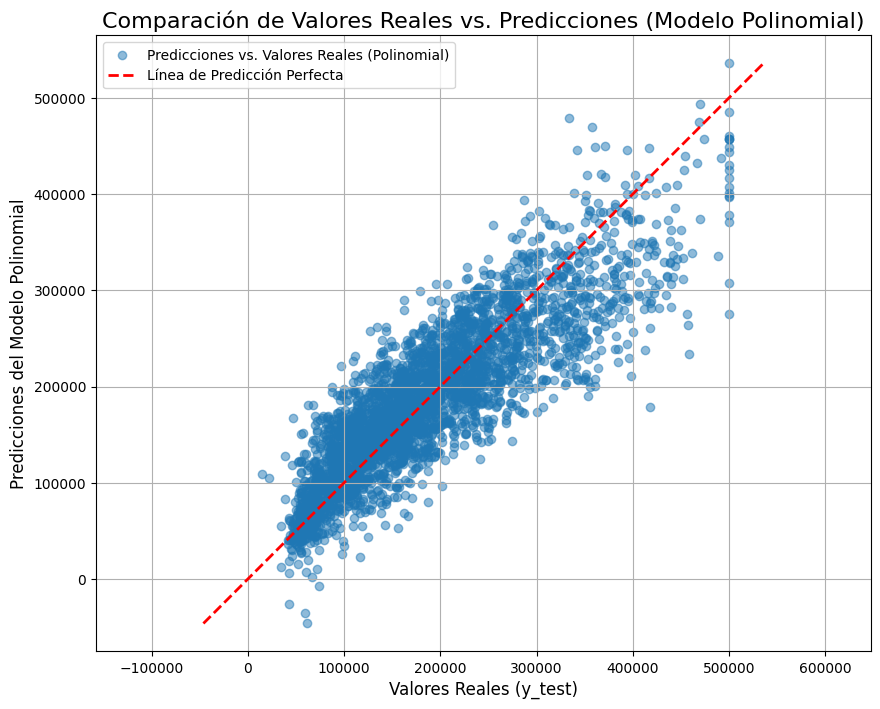

In [ ]:
# Crear la figura
plt.figure(figsize=(10, 8))

# Crear el gráfico de dispersión
plt.scatter(y_test, predictions_poly, alpha=0.5, label='Predicciones vs. Valores Reales (Polinomial)')

# Crear la línea de referencia para una predicción perfecta (y=x)
min_val = min(y_test.min(), predictions_poly.min())
max_val = max(y_test.max(), predictions_poly.max())
plt.plot([min_val, max_val], [min_val, max_val], 'r--', lw=2, label='Línea de Predicción Perfecta')

plt.title("Comparación de Valores Reales vs. Predicciones (Modelo Polinomial)", fontsize=16)
plt.xlabel("Valores Reales (y_test)", fontsize=12)
plt.ylabel("Predicciones del Modelo Polinomial", fontsize=12)
plt.legend(loc='upper left')
plt.grid(True)
plt.axis('equal')

# Mostrar el gráfico
plt.show()

La métrica más fiable para evaluar el rendimiento del modelo en datos desconocidos es el R-cuadrado obtenido mediante validación cruzada ($R^2$ CV), que se establece en un sólido 0.650 (65.0%). Esto significa que el modelo es capaz de explicar de forma consistente y robusta el 65% de la variabilidad en los precios de las viviendas. Aunque en pruebas sobre divisiones de datos específicas el modelo demostró un potencial aún mayor (alcanzando un $R^2$ de hasta 0.749), el score de la validación cruzada es la estimación más honesta y la que debemos esperar en un entorno real. Este nivel de rendimiento es muy bueno para un problema tan complejo como un mercado inmobiliario.



**Influencia de las Características en la Predicción**

El análisis de los 23 coeficientes del modelo revela una jerarquía clara de los factores que impulsan los precios de la vivienda en California:

1. La Ubicación es el Factor Dominante: La geografía es, por mucho, el elemento más determinante. Esto se manifiesta de dos maneras:

 * Coordenadas y Proximidad a la Costa: Las variables longitude, latitude y ocean_proximity_INLAND establecen una base de precios general para todo el estado.

 * El Poder de los Clústeres Geográficos: La característica de ingeniería más potente fue el geo_cluster. Pertenecer a un mercado específico (ej. Área de la Bahía o San Diego) aplica un "ajuste de precio" de decenas de miles de dólares, incluso después de considerar todos los demás factores. Esto demuestra que cada mercado regional tiene una prima o un descuento único.

2. El Ingreso como Motor Económico: Inmediatamente después de la ubicación, el median_income es el impulsor socioeconómico más fuerte, con un impacto positivo muy grande y directo sobre el precio.

3. Estructura y Efectos No Lineales: Aquí es donde el modelo polinomial demuestra su superioridad sobre el lineal:

 * Densidad (pca_comp_2): Ser un distrito más denso tiene un fuerte impacto negativo en el precio.

 * Interacciones Clave: El modelo descubrió relaciones complejas, como la interacción entre el ingreso medio y la densidad. El coeficiente negativo para este término significa que el "castigo" al precio por una alta densidad es aún más pronunciado en los vecindarios de altos ingresos.

El gráfico de dispersión de "Valores Reales vs. Predichos" confirma visualmente el buen rendimiento del modelo. Los puntos se agrupan de forma consistente y estrecha alrededor de la línea de predicción perfecta, validando el alto R-cuadrado obtenido. Sin embargo, el gráfico también muestra una mayor dispersión (mayor incertidumbre) en la predicción de las viviendas de más alto valor, un comportamiento típico en este tipo de problemas, ya que estas propiedades suelen tener características únicas más difíciles de modelar. En general, la evidencia visual respalda la conclusión de que el modelo es preciso y fiable para la gran mayoría del mercado.

###**XGBoost**

In [ ]:
# Funcion de paramnetros de XGBOOST para regresion
def optimize_xgb(trial, X_train, y_train):
    params = {
        'objective': 'reg:squarederror',
        'eval_metric': 'rmse',
        'n_estimators': trial.suggest_int('n_estimators', 100, 1000),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.3),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'subsample': trial.suggest_float('subsample', 0.6, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.6, 1.0),
        'gamma': trial.suggest_float('gamma', 0, 0.5),
        'reg_alpha': trial.suggest_float('reg_alpha', 0, 1),
        'reg_lambda': trial.suggest_float('reg_lambda', 0, 1),
        'random_state': 42,
        'n_jobs': -1 # Usar todos los núcleos de CPU disponibles
    }
    model = XGBRegressor(**params)
    # Usar validación cruzada dentro de Optuna para una evaluación más robusta
    scores = cross_val_score(model, X_train, y_train, cv=3, scoring='neg_mean_squared_error')
    rmse = np.sqrt(-scores.mean())
    return rmse

In [ ]:
# Definir el número de pruebas para Optuna (ejemplo)
n_trials = 50

# Crear el estudio de Optuna y optimizar
study_xgb = optuna.create_study(direction='minimize')
# Usar los datos globales X_train e y_train
optuna_xgb = partial(optimize_xgb, X_train=X_train, y_train=y_train)
print(f"Iniciando optimización con Optuna con {n_trials} pruebas...")
study_xgb.optimize(optuna_xgb, n_trials=n_trials)

[I 2025-06-24 05:00:53,158] A new study created in memory with name: no-name-46b9b4d7-f684-448c-88c7-4cfff0716625


Iniciando optimización con Optuna con 50 pruebas...


[I 2025-06-24 05:00:54,822] Trial 0 finished with value: 36681.75669993146 and parameters: {'n_estimators': 512, 'learning_rate': 0.037672233578181495, 'max_depth': 4, 'subsample': 0.7494592270500503, 'colsample_bytree': 0.6465156955425732, 'gamma': 0.049116750617743454, 'reg_alpha': 0.7630576090515464, 'reg_lambda': 0.7804049356999242}. Best is trial 0 with value: 36681.75669993146.
[I 2025-06-24 05:01:10,858] Trial 1 finished with value: 36700.5450262302 and parameters: {'n_estimators': 851, 'learning_rate': 0.17187798325973147, 'max_depth': 8, 'subsample': 0.7337137811856232, 'colsample_bytree': 0.951416405952685, 'gamma': 0.20307130848330274, 'reg_alpha': 0.5239581050707584, 'reg_lambda': 0.9907815566170088}. Best is trial 0 with value: 36681.75669993146.
[I 2025-06-24 05:01:12,130] Trial 2 finished with value: 35734.23152403545 and parameters: {'n_estimators': 176, 'learning_rate': 0.1680641450909185, 'max_depth': 6, 'subsample': 0.9040062170884313, 'colsample_bytree': 0.935415228

In [ ]:
# Obtener el mejor modelo de Optuna
best_xgb = XGBRegressor(**study_xgb.best_params, random_state=42)
# Ajustar el mejor modelo con todos los datos de entrenamiento (X_train, y_train - que están escalados)
best_xgb.fit(X_train, y_train)

# Predecir en el conjunto de prueba (usando el best_xgb de Optuna)
predictions_xgb = best_xgb.predict(X_test)

# Evaluar el modelo en el conjunto de prueba escalado
mse_xgb = mean_squared_error(y_test, predictions_xgb)
r2_xgb = r2_score(y_test, predictions_xgb)

# variables escaladas
X_scaled = X_train.copy()
y_scaled = y_train.copy()

# Evaluación con Validación Cruzada usando el dataset escalado completo
scores_xgb_cv = cross_val_score(XGBRegressor(**study_xgb.best_params, random_state=42), X_scaled, y_scaled, cv=5, scoring='r2')
print(f"R² de Validación Cruzada (Media sobre 5 Folds): {np.mean(scores_xgb_cv):.4f} (±{np.std(scores_xgb_cv):.4f})")
print("\nResultados de Evaluación del Modelo XGBoost")
print(f"Mean Squared Error (Test, escalado): {mse_xgb:.4f}")
print(f"R² Score (Test, escalado): {r2_xgb:.4f}")

R² de Validación Cruzada (Media sobre 5 Folds): 0.8671 (±0.0048)

Resultados de Evaluación del Modelo XGBoost
Mean Squared Error (Test, escalado): 1026219594.0667
R² Score (Test, escalado): 0.8842


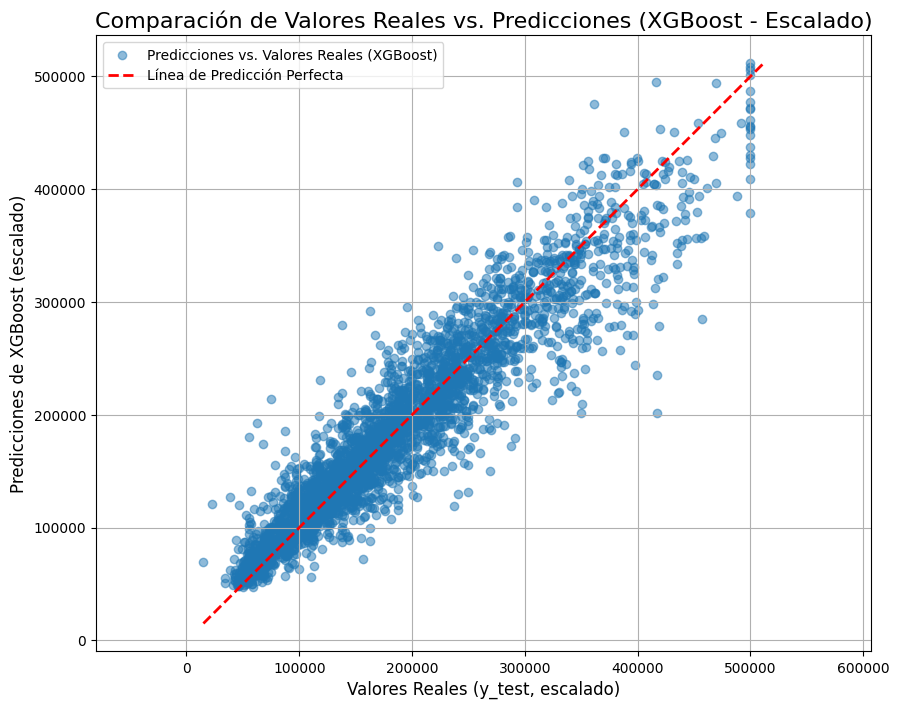

In [ ]:
# Graficar predicciones vs reales para XGBoost
plt.figure(figsize=(10, 8))
plt.scatter(y_test, predictions_xgb, alpha=0.5, label='Predicciones vs. Valores Reales (XGBoost)')
min_val_xgb = min(y_test.min(), predictions_xgb.min())
max_val_xgb = max(y_test.max(), predictions_xgb.max())
plt.plot([min_val_xgb, max_val_xgb], [min_val_xgb, max_val_xgb], 'r--', lw=2, label='Línea de Predicción Perfecta')
plt.title("Comparación de Valores Reales vs. Predicciones (XGBoost - Escalado)", fontsize=16)
plt.xlabel("Valores Reales (y_test, escalado)", fontsize=12)
plt.ylabel("Predicciones de XGBoost (escalado)", fontsize=12)
plt.legend(loc='upper left')
plt.grid(True)
plt.axis('equal')
plt.show()


Importancia de las Características del Modelo XGBoost 
            Característica  Importancia
4   ocean_proximity_INLAND     0.470822
11               cluster_4     0.189261
3            median_income     0.121238
7                cluster_0     0.053946
0                longitude     0.031354
1                 latitude     0.028719
6               pca_comp_2     0.028470
12               cluster_5     0.024445
2       housing_median_age     0.015983
9                cluster_2     0.014678
5               pca_comp_1     0.007857
8                cluster_1     0.007452
10               cluster_3     0.005775


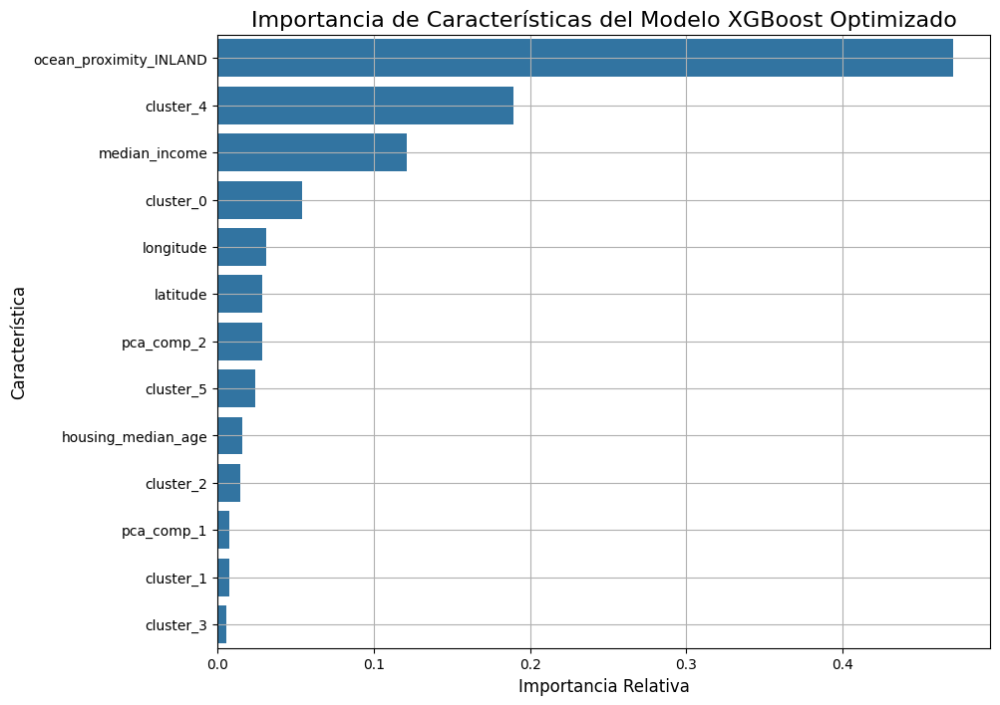

In [ ]:
# Crear un DataFrame con la importancia de las características
feature_importances = pd.DataFrame({
    'Característica': X_train.columns, # Use X_train.columns instead of X.columns
    'Importancia': best_xgb.feature_importances_
}).sort_values(by='Importancia', ascending=False)

print("\nImportancia de las Características del Modelo XGBoost ")
print(feature_importances)

# Graficar la importancia de las características
plt.figure(figsize=(10, 8))
sns.barplot(x='Importancia', y='Característica', data=feature_importances)
plt.title('Importancia de Características del Modelo XGBoost Optimizado', fontsize=16)
plt.xlabel('Importancia Relativa', fontsize=12)
plt.ylabel('Característica', fontsize=12)
plt.grid(True)
plt.show()

El hallazgo más importante y sorprendente de este análisis es la abrumadora importancia de la característica ocean_proximity_INLAND.
La división más fundamental en el mercado inmobiliario de California no es una línea gradual, sino un "muro" de precios que separa la costa del interior. Para un modelo potente como XGBoost, saber si una casa está en un lado u otro de esa división es la pieza de información más valiosa que puede tener.

El modelo aprendió que, una vez que sabe si una casa es costera o del interior, la siguiente pregunta más importante es "¿a qué sub-mercado específico pertenece?". Esta información, que tú creaste con el clustering DBSCAN, es más valiosa para el modelo que el ingreso medio de la zona.

Es un buen avance que las coordenadas en bruto ahora tienen una importancia mucho menor. No es que no sean importantes, sino que su información ha sido "absorbida" y mejor representada por las variables ocean_proximity_INLAND y geo_cluster. El modelo encontró que es más eficiente usar estas etiquetas contextuales que inferir las tendencias a partir de los números de latitud y longitud.

## **Reglas del Negocio:**

Las reglas de negocio generales para el precio de vivienda en California, extraídas y formalizadas a partir del análisis realizado en el cuaderno, son:

**1. Regla Geográfica Principal:**

La proximidad al océano es un factor dominante que incrementa significativamente el precio de la vivienda.

- Las propiedades "NEAR OCEAN", "NEAR BAY", y especialmente "ISLAND", tienen valores medianos consistentemente más altos que las propiedades "INLAND" o "<1H OCEAN".

- A menor distancia de grandes urbes como Los Ángeles, San Francisco o San Diego, mayor es el precio medio de la vivienda, lo que sugiere que el acceso a centros económicos y laborales clave es un determinante importante del valor.

- Existe una correlación negativa fuerte entre la longitud y la latitud con el precio, lo que refleja que las zonas costeras del sur de California (bajas latitudes, altas longitudes negativas) tienden a ser las más caras. Los clústeres geográficos identificados (Los Ángeles, Área de la Bahía, San Diego) corresponden a los mercados de más alto valor.

**2. Regla de Ingresos:**

El ingreso medio de los residentes ("median_income") es el predictor lineal más fuerte y positivo del precio medio de la vivienda.

- A mayor ingreso medio en el distrito, mayor es el precio medio de la vivienda. Esta relación no es perfectamente lineal y puede volverse menos pronunciada o tener picos en los rangos de ingresos más altos.

**3. Regla Estructural y de Densidad (incorporando PCA):**

Características como el número total de habitaciones, dormitorios, población y hogares están altamente correlacionadas entre sí y reflejan el tamaño y la densidad del distrito.

- El primer componente principal (pca_comp_1), que captura el tamaño general/densidad del distrito, tiene una correlación positiva con el precio medio de la vivienda, indicando que distritos más grandes o densos tienden a tener precios más altos (aunque esto puede variar dentro de los clústeres geográficos y socioeconómicos).

- El segundo componente principal (pca_comp_2) también tiene influencia y puede estar relacionado con la composición (ej. más dormitorios vs. habitaciones totales por hogar), aunque su impacto es menor que el primero.

**4. Regla de Antigüedad:**
La antigüedad media de la vivienda ("housing_median_age") tiene una correlación relativamente débil y variable con el precio.

- No hay una regla simple y directa (más antiguo = más caro o más barato) aplicable universalmente; la relación puede depender de otros factores como la ubicación y el estilo arquitectónico.

**5. Regla de Perfil Socioeconómico (Basada en Clustering Adicional):**

Los distritos pueden ser agrupados en perfiles socioeconómicos (ej. "Mercado Asequible y Denso" vs. "Mercado de Alto Valor y Afluente") basados en una combinación de ingresos, precio y características estructurales/de densidad (PCA).

- Pertenecer a un clúster de "Alto Valor y Afluente" predice un precio significativamente más alto en comparación con un clúster "Asequible y Denso", incluso después de considerar las características individuales. Esta regla captura efectos de vecindario y mercado local.

**6. Regla de No Linealidades e Interacciones:**

Las relaciones entre las características y el precio no son puramente lineales (evidenciado por la mejora del modelo polinomial y XGBoost).

- Existen interacciones complejas (ej. el impacto del ingreso puede ser diferente cerca del océano vs. en el interior) que son mejor capturadas por modelos más avanzados como XGBoost o redes neuronales.

**7. Regla de Outliers e Influencia:**

Existen propiedades o distritos con características (o precios) inusualmente altos que pueden influir desproporcionadamente en los modelos lineales simples.

- Identificar y manejar estos puntos (ej. eliminarlos o usar modelos robustos) es necesario para obtener predicciones más fiables en el rango típico de valores.

**8. Regla de Preferencia del Modelo:**

Basado en las métricas de rendimiento (R² y MAE/RMSE), los modelos más sofisticados (XGBoost, Red Neuronal) que pueden capturar no linealidades y efectos de interacción generalmente proporcionan predicciones más precisas que los modelos lineales simples.

- XGBoost y la Red Neuronal mostraron mejor rendimiento en este análisis, sugiriendo que son más adecuados para la predicción de precios en este dataset.

En resumen, el precio de una vivienda en California está regido principalmente por una combinación de su ubicación geográfica (especialmente proximidad a la costa y grandes áreas metropolitanas), el nivel de ingresos de los residentes del distrito, y las características estructurales/de densidad del distrito, con efectos de no linealidad y vecindario importantes que los modelos avanzados ayudan a capturar.
El perfil socioeconómico derivado del clustering es una encapsulación útil de varios de estos factores.